# Import

In [1]:
import torch 
### 토치확인
print("pytorch cuda 여부")
print(torch.cuda.is_available())
print('#'*50)

from tensorflow.python.client import device_lib
print("tensorflow cuda 여부")
print(device_lib.list_local_devices())
print('#'*50)

import os
os.environ["CUDA_VISIBLE_DEVICES"]="0" # -1이면 cpu사용

pytorch cuda 여부
True
##################################################
tensorflow cuda 여부
[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 10675699987823772856
xla_global_id: -1
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 5748293632
locality {
  bus_id: 1
  links {
  }
}
incarnation: 9835925114287805964
physical_device_desc: "device: 0, name: NVIDIA GeForce RTX 3060 Ti, pci bus id: 0000:01:00.0, compute capability: 8.6"
xla_global_id: 416903419
]
##################################################


In [2]:
import os
import numpy as np
import pandas as pd
from datetime import datetime, timedelta
from math import sqrt

import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
plt.style.use(["seaborn-v0_8-muted"])
seaborn_style = [style for style in matplotlib.style.available if "seaborn" in style]
import plotly.graph_objects as go

from pycaret.regression import *
from pycaret.regression import load_model
import lightgbm as lgb

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'
import warnings
warnings.filterwarnings(action='ignore')

from sklearn.metrics import mean_squared_error

NameError: name 'matplotlib' is not defined

# Personal function

## Create train_set

In [ ]:
def create_lagged_dataset(input_data, lead_minutes):
    """
    선행시간에 따라 데이터셋을 shift 해주는 함수

    Parameters:
    - input_data: 원본 데이터 
    - lag_minutes: 선행시간 

    Return:
    - X_lagged: 선행시간 만큼 shift
    - y_lagged: Lagged target values
    """
    
    # target을 제외한 행들을 선행시간만큼 미룸(선행시간 lag_minutes까지의 데이터로 예측하기 위함.)
    X_lagged = input_data.drop(columns=['wl_jamsu']).shift(lead_minutes//10)

    y_lagged = input_data['wl_jamsu'].iloc[lead_minutes//10:]

    X_lagged = X_lagged.iloc[lead_minutes//10:]

    return X_lagged, y_lagged

In [ ]:
def prepare_datasets_all(input_data, start_year, end_year, lead_minutes):
    """
    전체 월로 학습시키는 데이터 셋 생성 함수,

    Parameters:
    - input_data: 원본 데이터 
    - start_year: 학습 데이터 시작일
    - end_year: 검증 데이터 시작일
    - lead_minutes: 선행시간

    Returns:
    - X_train: 학습 데이터 features
    - y_train: 학습 데이터 target
    - X_test: 검증 데이터 features
    - y_test: 검증 데이터 target
    """
    
    # 선행시간 만큼 train set의 시작점을 미뤄줌
    # ex 선행시간 10분일 때 01:00의 target을 예측하기위해서, 00:50분의 feature가 필요
    train_start_adjusted = pd.Timestamp(f"{start_year}-01-01 00:00:00") - pd.Timedelta(minutes=10)
    train_data = input_data[train_start_adjusted:f"{end_year-1}-12-31 23:50:00"]
    test_data = input_data[f"{end_year}"]

    X_train, y_train = create_lagged_dataset(train_data, lead_minutes)
    X_test, y_test = create_lagged_dataset(test_data, lead_minutes)

    return (X_train, y_train, X_test, y_test)

In [ ]:
def create_datasets_part(input_data, start_year, end_year, lead_minutes, months_set_1,months_set_2):
    """
    특정 월로 학습시키는 데이터 셋 생성 함수

    Parameters:
    - input_data: 원본 데이터 
    - start_year: 학습 데이터 시작일
    - end_year: 검증 데이터 시작일
    - lead_minutes: 선행시간
    - months_set_1: 첫번째 데이터셋의 월 구성
    - months_set_2: 두번째 데이터셋의 월 구성

    Returns:
    - X_train_1, y_train_1, X_test_1, y_test_1: 1-6, 11, 12 월로 구성된 학습, 검정 데이터 셋 
    - X_train_2, y_train_2, X_test_2, y_test_2: 7-10 월로 구성된 학습, 검정 데이터셋 
    """

    train_data = input_data[str(start_year):str(end_year-1)]
    test_data = input_data[str(end_year)]

    train_data_set_1 = train_data[train_data.index.month.isin(months_set_1)]
    test_data_set_1 = test_data[test_data.index.month.isin(months_set_1)]

    train_data_set_2 = train_data[train_data.index.month.isin(months_set_2)]
    test_data_set_2 = test_data[test_data.index.month.isin(months_set_2)]

    X_train_1, y_train_1 = create_lagged_dataset(train_data_set_1, lead_minutes)
    X_test_1, y_test_1 = create_lagged_dataset(test_data_set_1, lead_minutes)

    X_train_2, y_train_2 = create_lagged_dataset(train_data_set_2, lead_minutes)
    X_test_2, y_test_2 = create_lagged_dataset(test_data_set_2, lead_minutes)

    return (X_train_1, y_train_1, X_test_1, y_test_1), (X_train_2, y_train_2, X_test_2, y_test_2)


## Evaluate pred_result

In [ ]:
def feature_importance(leadtime, max_n):
    """
    lgbm 모델의 feature importance를 불러오는 함수.
    final_model-1 기준으로 불러오게 되어있으나, 1~3까지로 수정 가능. 
    """
    model = load_model(f'../model/leadtime({leadtime})/final_model-1').steps[-1][1]
    importance = lgb.plot_importance(model, max_num_features=max_n, figsize=(6, 4), ax=ax)
    ax.set_title(f'Leadtime {leadtime} Feature Importance',fontsize=15)
    return 0

In [ ]:
def plot_compare(answer_data,pred_data):
    """
    실제 데이터와 예측 데이터를 비교하는 함수
    1. scatter plot
    2. line plot
    """
    
    # 오차(rmse) 계산
    rmse = mean_squared_error(answer_data['wl_jamsu'], pred_data['pred_wl_jamsu'], squared=False)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 7))

    # Scatter plot
    ax1.scatter(answer_data['wl_jamsu'], pred_data['pred_wl_jamsu'])
    ax1.set_xlabel('x')
    ax1.set_ylabel('y')
    ax1.set_title('Actual vs. Predicted Water Levels')
    ax1.set_aspect('equal', adjustable='box')

    # Line plot
    ax2.text(0.05, 0.95, '  {:.3f}  '.format(rmse),fontsize=30, ha='right', va='top', transform=ax2.transAxes)
    ax2.plot(answer_data.index, answer_data['wl_jamsu'], label='Actual', color='blue', alpha=0.5)
    ax2.plot(answer_data.index, pred_data['pred_wl_jamsu'], label='Predicted', color='red', linestyle='--', alpha=0.5)
    ax2.set_xlabel('Time')
    ax2.set_ylabel('Water Level')
    ax2.set_title('Actual vs. Predicted Water Levels')
    ax2.legend()
    ax2.grid(True)

    plt.tight_layout()
    plt.show()

In [ ]:
def plot_month(answer_data,pred_data,len_m):
    """
    1. scatter plot: 실제 데이터와 예측 데이터의 오차를 월별로 보여주는 함수
    2. bar plot: 예측 데이터의 오차를 월별로 보여주는 함수 
    
    """
    
    used_data=pd.concat([answer_data,pred_data],axis=1)
    used_data.index=pd.to_datetime(used_data.index)

    grouped = used_data.groupby(used_data.index.month)
    year = used_data.index[0].year

    fig, axes = plt.subplots(nrows=len_m//2, ncols=2, figsize=(20, len_m*2))
    axes = axes.ravel()  
    month_names = ["January", "February", "March", "April", "May", "June", "July", "August", 
                "September", "October", "November", "December"]

    month_rmse = []
    
    # Line plot
    for (month, m_data), ax in zip(grouped, axes):
        actual = m_data['wl_jamsu']
        predicted = m_data['pred_wl_jamsu']
        
        rmse = mean_squared_error(actual, predicted, squared=False)
        month_rmse.append(rmse)
        
        ax.plot(m_data.index, actual, label='Actual', color='blue', alpha=0.5)
        ax.plot(m_data.index, predicted, label='Predicted', color='red', linestyle='--', alpha=0.5)
        ax.set_title(f'{month_names[month-1]}, {year} - RMSE: {rmse:.2f}')
        ax.set_xlabel('Time')
        ax.set_ylabel('Water Level')
        ax.legend()
        ax.grid(True)

    plt.tight_layout()
    plt.show();
    
    # Bar plot
    plt.figure(figsize=(10, 6))
    plt.bar(range(len(month_rmse)), month_rmse, color='skyblue', edgecolor='black')
    plt.ylabel('RMSE')
    plt.xlabel('Month')
    plt.title(f'RMSE by Month for {year}')
    plt.xticks(range(len(month_rmse)), [month_names[i-1] for i in grouped.groups.keys()], rotation=45)
    plt.grid(axis='y')
    plt.tight_layout()
    plt.show();


## Final_pred 

In [ ]:
def make_model(data,leadtime,n):
    """
    eda 및 feature engineering이 완료된 이후, 
    선행시간 별 모델 학습 및 예측을 위한 함수 
    
    모델 생성. 

    """
    train=pd.concat([data[0],data[1]],axis=1)
    test=pd.concat([data[2],data[3]],axis=1)
    
    setups = setup(data=train, test_data = test, target='wl_jamsu', 
                fold_strategy = 'kfold',fold=5, data_split_shuffle=True, 
                remove_outliers= False, transformation=False, session_id=624, use_gpu=True,verbose=False)
    
    model= create_model('lightgbm',verbose=False)
    model_tuned = tune_model(model,choose_better = True,search_library = 'optuna',verbose=False)
    os.makedirs(f"../model/leadtime({leadtime})",exist_ok=True)
    save_model(model_tuned, f'../model/leadtime({leadtime})/final_model-{n}')

    return 0

In [ ]:
def get_model_input(data, lead_time_minutes):
    
    # 특정 시점의 데이터를 예측하기 위한, 학습 데이터 준비 
    start_time = datetime(2023, 1, 1) - timedelta(minutes=lead_time_minutes)
    
    input_data = data[data.index >= start_time.strftime('%Y-%m-%d %H:%M:%S')]
    
    input_data.drop(['wl_jamsu'],axis=1,inplace=True)
    
    return input_data

In [ ]:
def make_pred(data,leadtime, n):
    
    """
    모델 3개를 이용하여 각각 학습, 예측한 후
    특정 모델에서 특정 월의 결과를 가져오는 함수. 
    """
    
    # 모델에서 어떤 월을 가져올지. 
    selected_months = [[3, 4, 5, 6, 11, 12,8,9,10],[1,2],[7]]
    
    input_data = get_model_input(data, leadtime)
    model = load_model(f'../model/leadtime({leadtime})/final_model-{n}') 
    y_pred = model.predict(input_data,verbose=0)
    y_pred=pd.DataFrame(y_pred[:-(leadtime//10)],index=answer.index)
    
    y_pred.to_csv(f'../result/leadtime({leadtime})/final_model-{n}.csv')
    y_pred=y_pred[y_pred.index.month.isin(selected_months[n-1])]
    
    return y_pred
    

In [ ]:
def predict_wl_level(data,leadtime):
    
    print("#"*50)
    print(f"Leadtime {leadtime} predict start")
    
    months_set_1 = [1, 2, 3, 4, 5, 6, 11, 12]
    months_set_2 = [7, 8, 9, 10]
    
    # 모델 및 예측 기록이 이미 저장되어있는지 확인. 
    f_name1,f_name2,f_name3='final_model-1.pkl','final_model-2.pkl','final_model-3.pkl'
    os.makedirs(f"../model/leadtime({leadtime})",exist_ok=True)
    f_dir= os.listdir(f"../model/leadtime({leadtime})/")
    r_name=f"lt({leadtime})_predict.csv"
    os.makedirs(f"../result/leadtime({leadtime})",exist_ok=True)
    r_dir=os.listdir(f"../result/leadtime({leadtime})/")
    
    # 전체월로 학습하는 모델 데이터 셋 준비 
    full_data= prepare_datasets_all(data, 2013, 2023, leadtime)
    # 전체월로 모델 학습 
    if f_name1 not in f_dir: make_model(full_data,leadtime,1)
    
    
    # 부분월로 학습하는 모델 데이터셋 준비 
    sep_data= create_datasets_part(data, 2013, 2023, leadtime ,months_set_1,months_set_2)
    # 부분월로 모델 학습 
    if f_name2 not in f_dir: make_model(sep_data[0],leadtime,2)
    if f_name3 not in f_dir: make_model(sep_data[1],leadtime,3)
    
    # 생성된 모델을 이용하여 테스트셋의 각월을 예측. 
    if r_name not in r_dir: 
        pred_1=make_pred(data,leadtime,1)
        pred_2=make_pred(data,leadtime,2)
        pred_3=make_pred(data,leadtime,3)
    
        pred = pd.concat([pred_1, pred_2, pred_3]).sort_index()
        pred.columns=['pred_wl_jamsu']
        pred.to_csv(f'../result/leadtime({leadtime})/lt({leadtime})_predict.csv')
    else: 
        pred=pd.read_csv(f'../result/leadtime({leadtime})/'+r_name)
        pred.set_index('ymdhm',drop=True,inplace=True)
        pred.index=pd.to_datetime(pred.index)
    
    return pred
    

# Data load

In [ ]:
data=pd.read_csv("../data/full_data.csv")
data.set_index('ymdhm',inplace=True)
data.index=pd.to_datetime(data.index)
data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 565200 entries, 2013-01-01 00:00:00 to 2023-09-30 23:50:00
Data columns (total 25 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   wl_jamsu      565200 non-null  float64
 1   fw_jamsu      96819 non-null   float64
 2   wl_cheongdam  565200 non-null  float64
 3   fw_cheongdam  499875 non-null  float64
 4   wl_haengju    565200 non-null  float64
 5   fw_haengju    564939 non-null  float64
 6   wl_hangang    565200 non-null  float64
 7   fw_hangang    561917 non-null  float64
 8   wl_gwangin    565200 non-null  float64
 9   fw_gwangin    443666 non-null  float64
 10  wl_paldang    565200 non-null  float64
 11  fw_paldang    565140 non-null  float64
 12  wl_jungnang   565200 non-null  float64
 13  fw_jungnang   565141 non-null  float64
 14  wl_jeollyuri  565200 non-null  float64
 15  fw_jeollyuri  96803 non-null   float64
 16  swl           562228 non-null  float64
 17  inf           

# EDA

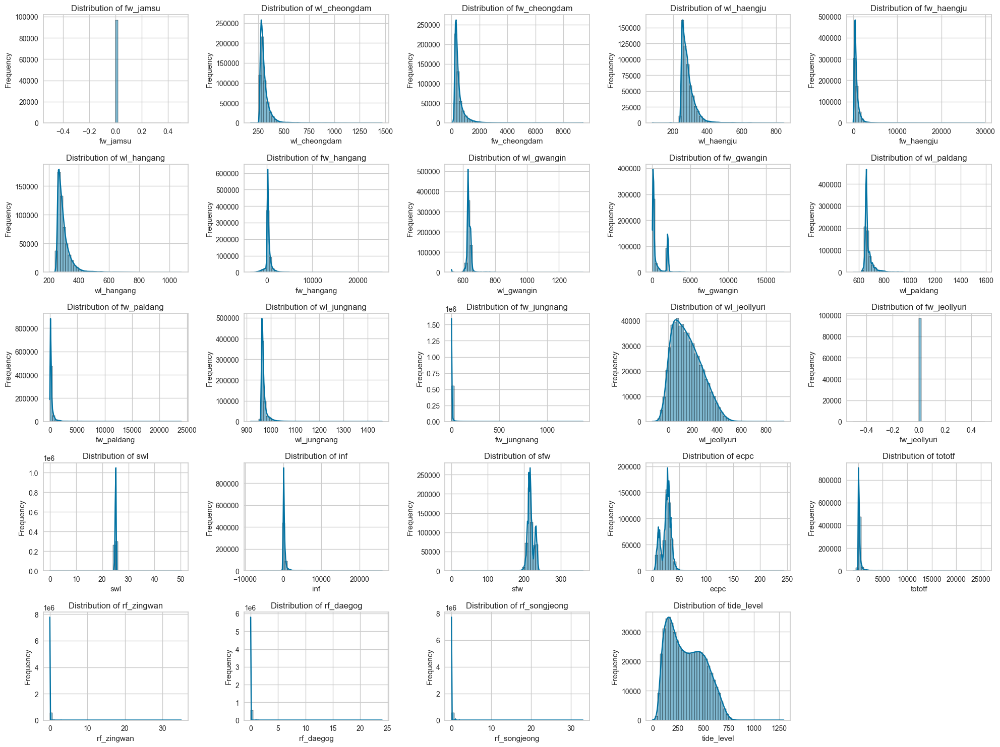

In [ ]:
plt.figure(figsize=(20, 15))

for idx, col in enumerate(data.columns.drop('wl_jamsu'), 1):
    plt.subplot(5, 5, idx)
    sns.histplot(data[col], bins=50, kde=True)
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')

plt.tight_layout()
plt.show();

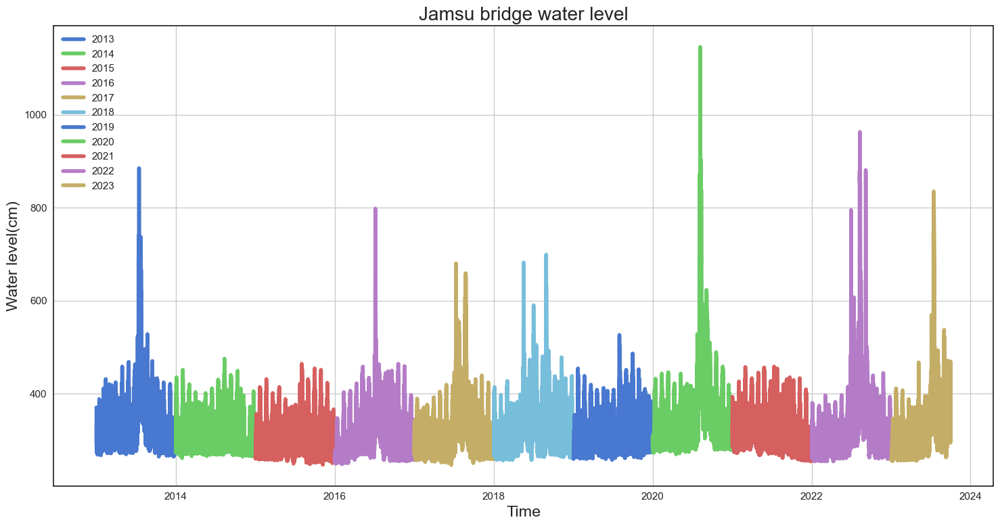

In [ ]:
grouped_by_year = data.groupby(data.index.year)

plt.figure(figsize=(15, 8))
for year, group in grouped_by_year:
    plt.plot(group.index, group['wl_jamsu'], label=str(year))

plt.xlabel('Time')
plt.ylabel('Water level(cm)')
plt.title('Jamsu bridge water level')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show();
del grouped_by_year;

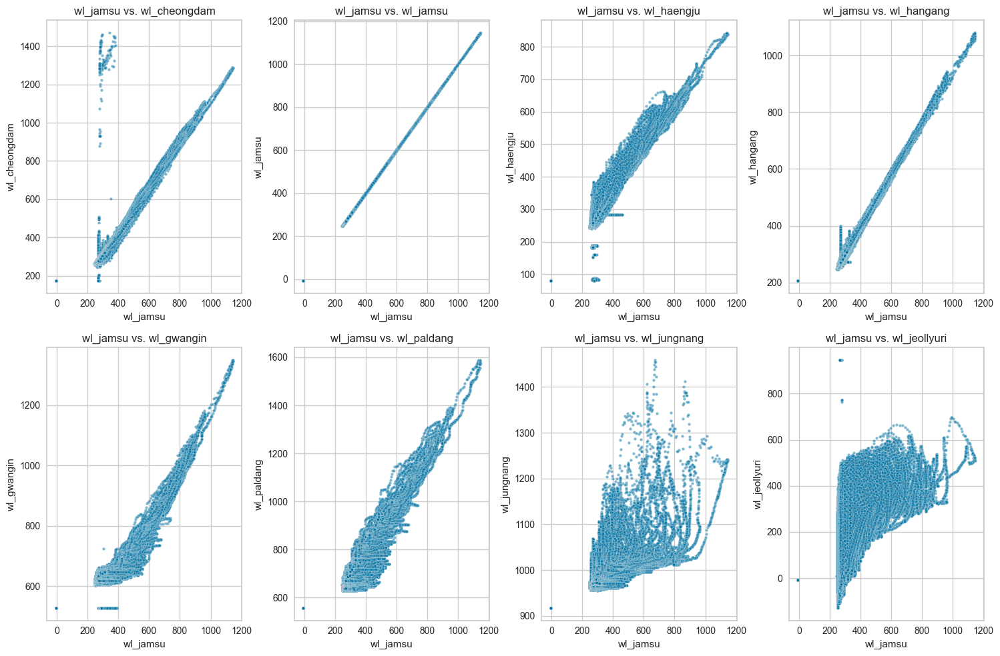

In [ ]:
bridges_wl = ['wl_cheongdam', 'wl_jamsu','wl_haengju', 'wl_hangang', 'wl_gwangin', 'wl_paldang', 'wl_jungnang','wl_jeollyuri']

plt.figure(figsize=(15, 10))

for i, bridge in enumerate(bridges_wl, 1):
    plt.subplot(2, 4, i)
    sns.scatterplot(x=data['wl_jamsu'], y=data[bridge], alpha=0.5, s=10)
    plt.title(f'wl_jamsu vs. {bridge}')
    plt.xlabel('wl_jamsu')
    plt.ylabel(bridge)

plt.tight_layout()
plt.show();

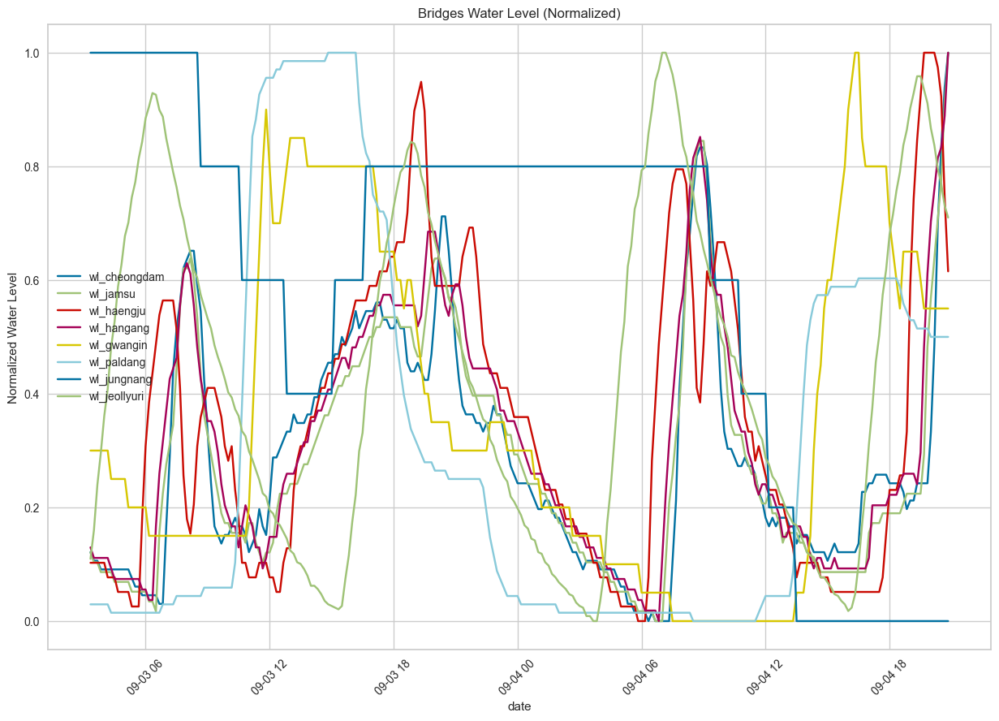

In [ ]:
# Min-Max 스케일링 함수 정의
def min_max_scaling(data):
    min_val = min(data)
    max_val = max(data)
    scaled_data = [(x - min_val) / (max_val - min_val) for x in data]
    return scaled_data

# 보고자 하는 데이터 시작, 끝 인덱스
start, end = 35300, 35550

plt.figure(figsize=(15, 10))

# 데이터 정규화 및 그래프 그리기
for bridge in bridges_wl:
    normalized_data = min_max_scaling(data[bridge][start:end])
    sns.lineplot(x=data.index[start:end], y=normalized_data, label=bridge)

plt.xlabel('date')
plt.ylabel('Normalized Water Level')
plt.title('Bridges Water Level (Normalized)')
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.show();


In [ ]:
tmp=data.copy()
tmp['ymdhm'] = tmp.index

tmp['year'] = tmp['ymdhm'].dt.year
tmp['month'] = tmp['ymdhm'].dt.month
tmp['day'] = tmp['ymdhm'].dt.day
tmp['hour'] = tmp['ymdhm'].dt.hour
tmp['minute'] = tmp['ymdhm'].dt.minute

month_names = ["January", "February", "March", "April", "May", "June", "July", "August", 
                "September", "October", "November", "December"]

# 그래프 생성
fig = go.Figure()

# 모든 월과 년도의 데이터를 그래프에 추가
for month in range(1, 13):
    for year in range(2013, 2023):
        monthly_data = tmp[(tmp['year'] == year) & (tmp['month'] == month)]
        showlegend = True if month == 1 else False  # 범례는 1월의 데이터에만 표시
        fig.add_trace(
            go.Scatter(x=monthly_data['day'] + monthly_data['hour']/24 + monthly_data['minute']/1440,
                       y=monthly_data['wl_jamsu'],
                       name=f'{year}년',
                       mode='lines',
                       visible='legendonly',  # 기본적으로 모든 데이터를 'legendonly' 상태로 설정
                       showlegend=showlegend,
                       opacity=0.7)
        )

# 드롭다운 메뉴 설정
updatemenu = []
buttons = []
for index, month_name in enumerate(month_names):
    visible = ['legendonly'] * (12 * 10)  # 모든 월과 년도에 대한 가시성 배열 설정
    button = dict(
        args=[{'visible': visible}],
        label=month_name,
        method='update'
    )
    buttons.append(button)

updatemenu.append(go.layout.Updatemenu(buttons=buttons, direction="down"))


# 그래프의 레이아웃 설정 및 표시
fig.update_layout(
    title_text='잠수교 월별 시계열 데이터 (2013-2023)', 
    updatemenus=updatemenu,
    width=1000,  # 그래프 너비 설정
    height=600  # 그래프 높이 설정
)
fig.show();

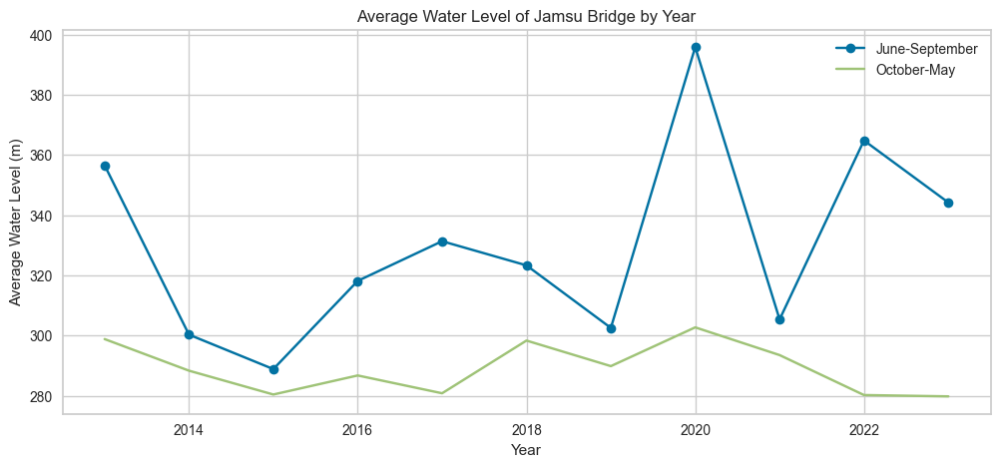

In [ ]:
# 각 년별로 6-9월(홍수기)평균과, 10-5월 비홍수기 잠수교 수위평균 비교
data_6to9 = data[data.index.month.isin(range(6, 10))]
data_10to5 = data[~data.index.month.isin(range(6, 10))]

mean_6to9 = data_6to9.groupby(data_6to9.index.year)['wl_jamsu'].mean()
mean_10to5 = data_10to5.groupby(data_10to5.index.year)['wl_jamsu'].mean()

plt.figure(figsize=(12, 5))
mean_6to9.plot(label="June-September", marker='o')
mean_10to5.plot(label="October-May", marker='x')
plt.title('Average Water Level of Jamsu Bridge by Year')
plt.xlabel('Year')
plt.ylabel('Average Water Level (m)')
plt.legend()
plt.grid(True)
plt.show();


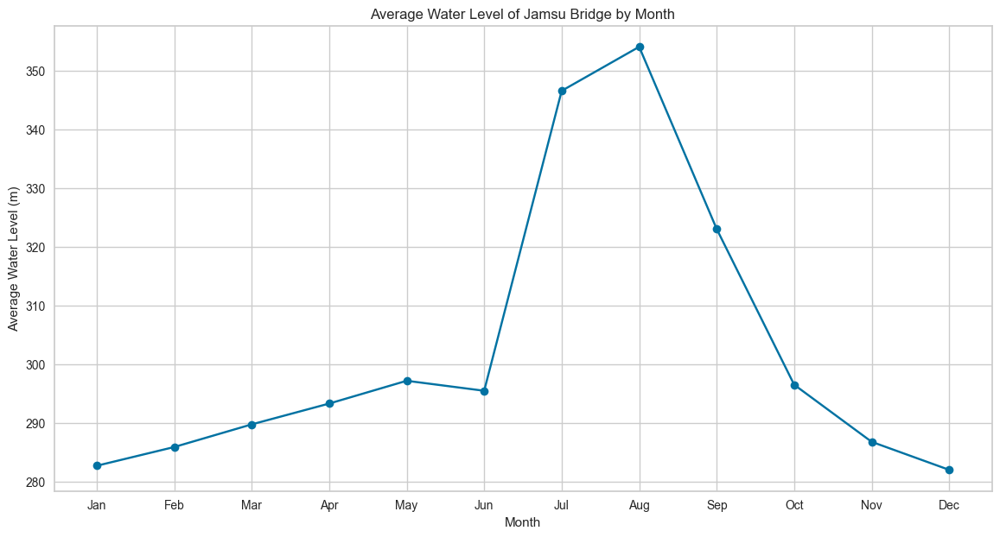

In [ ]:
# 월별 평균 수위 비교
mean_by_month = data.groupby(data.index.month)['wl_jamsu'].mean()

plt.figure(figsize=(14, 7))
mean_by_month.plot(label="Average Water Level by Month", marker='o')
plt.title('Average Water Level of Jamsu Bridge by Month')
plt.xlabel('Month')
plt.xticks(list(range(1, 13)), ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"])
plt.ylabel('Average Water Level (m)')
plt.grid(True)
plt.show();

# Preprocessing

## wl_jamsu(잠수교 수위)

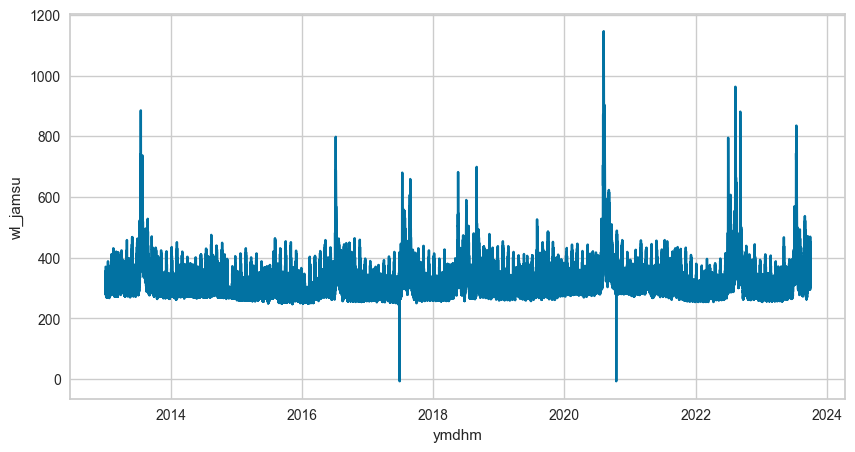

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['wl_jamsu'], ax=ax)
plt.show();

In [ ]:
data[data['wl_jamsu']<200][['wl_jamsu']]
data['wl_jamsu']=data['wl_jamsu'].replace(-6.8,np.nan);

## fw_jamsu(잠수교 유량)

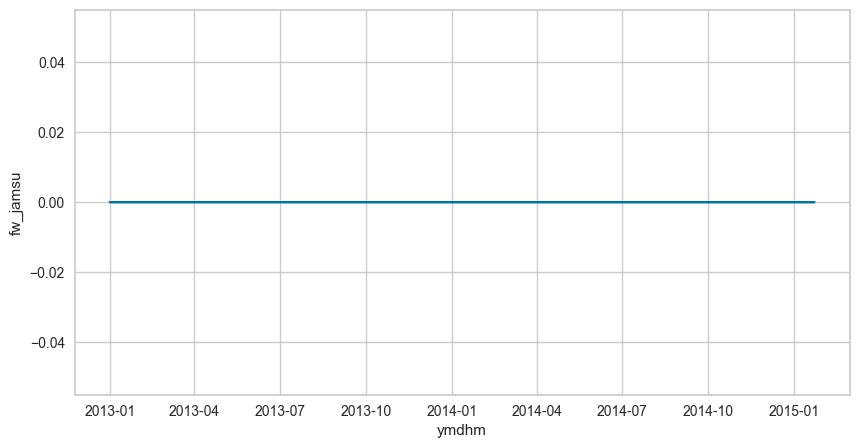

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['fw_jamsu'], ax=ax)
plt.show();

In [ ]:
data.drop('fw_jamsu',inplace=True, axis=1)

## wl_cheongdam(청담대교 수위)

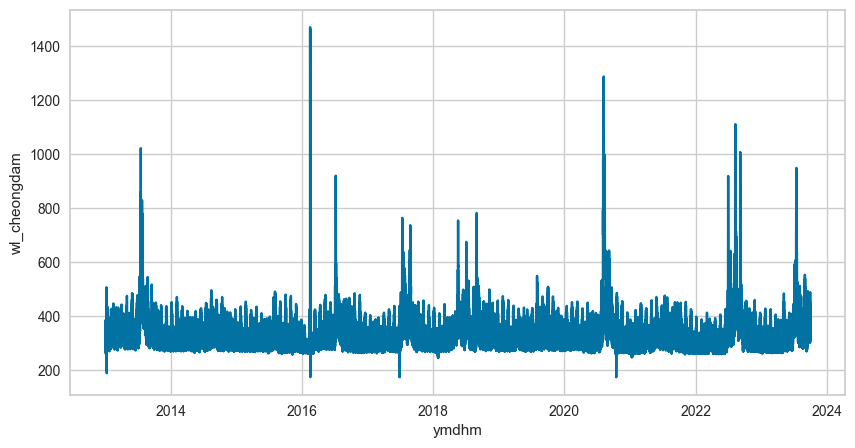

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['wl_cheongdam'], ax=ax)
plt.show();

In [ ]:
data.loc[data['wl_cheongdam'] <= 250, 'wl_cheongdam'] = np.nan

## fw_cheongdam(청담대교 유량)

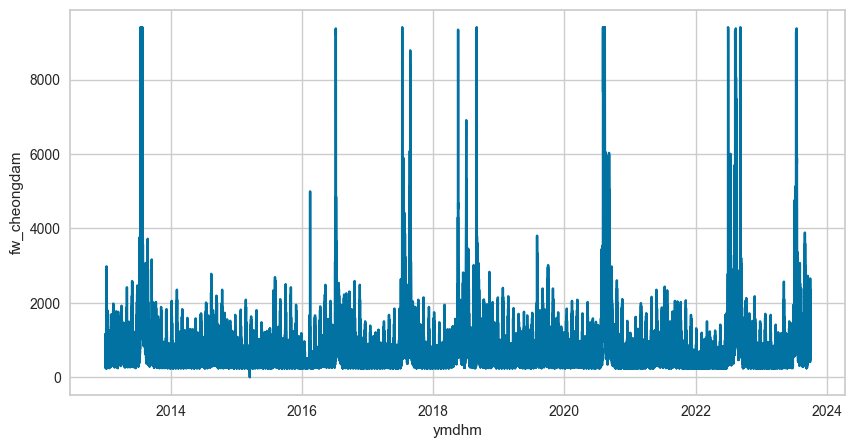

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['fw_cheongdam'], ax=ax)
plt.show();

In [ ]:
data.loc[data['fw_cheongdam'] <= 5, 'fw_cheongdam'] = np.nan

## wl_haengju(행주대교 수위)

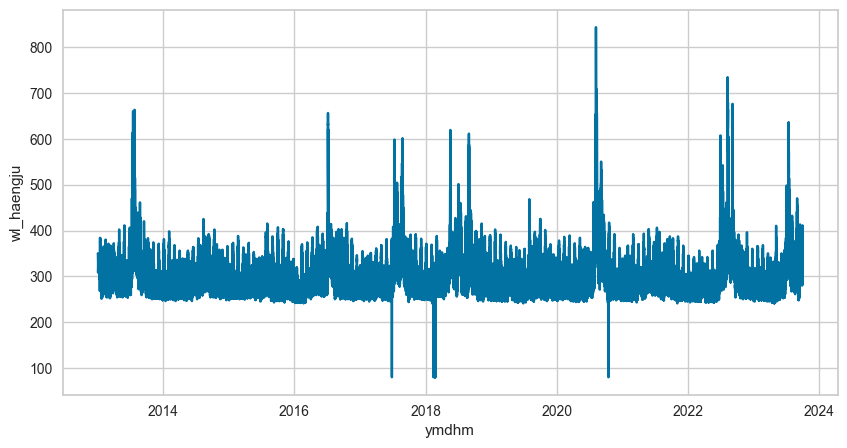

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['wl_haengju'], ax=ax)
plt.show();

In [ ]:
data.loc[data['wl_haengju'] <= 200, 'wl_haengju'] = np.nan

## fw_haengju(행주대교 유량)

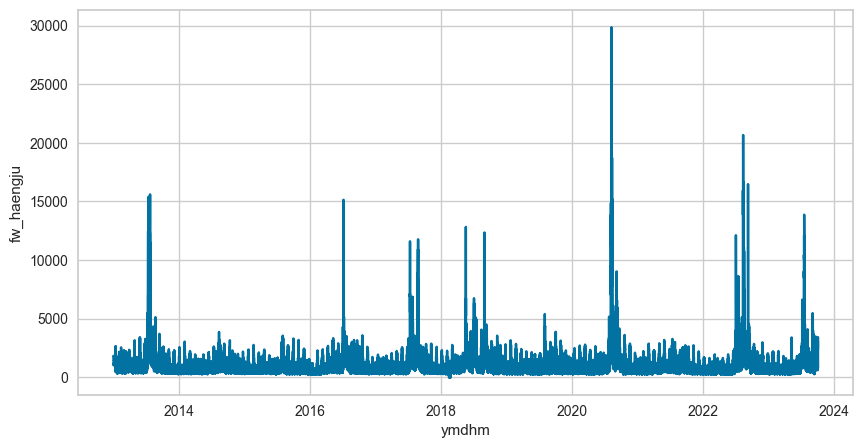

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['fw_haengju'], ax=ax)
plt.show();

## wl_hangang(한강대교 수위)

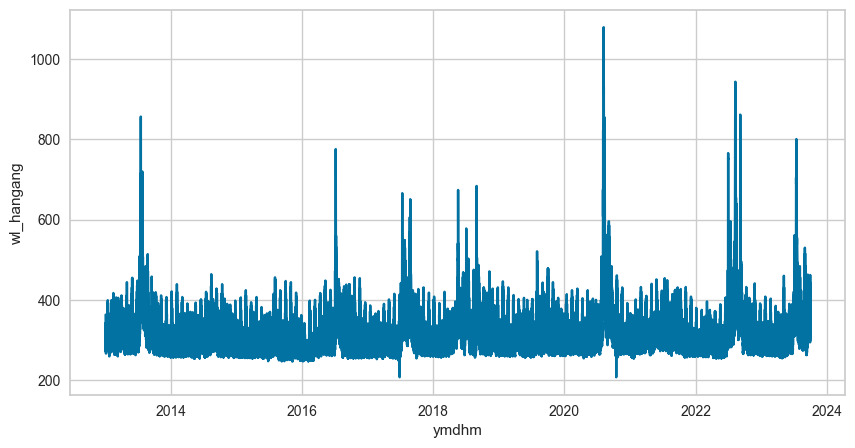

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['wl_hangang'], ax=ax)
plt.show();

In [ ]:
data.loc[data['wl_hangang'] <= 210, 'wl_hangang'] = np.nan;

## fw_hangang(한강대교 유량)

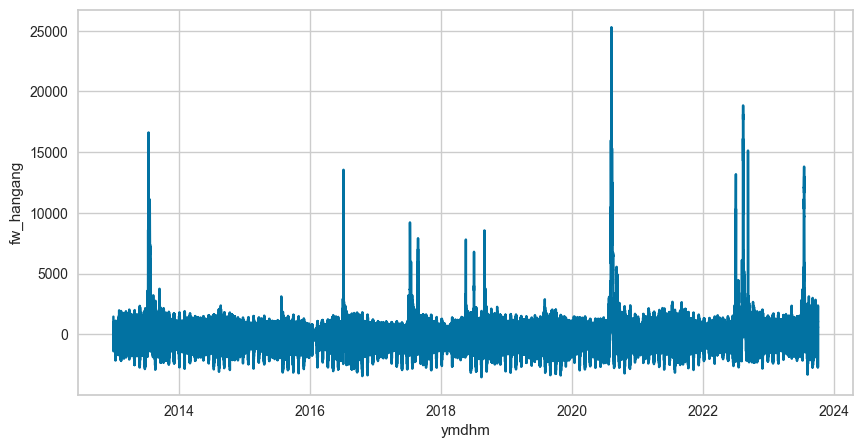

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['fw_hangang'], ax=ax)
plt.show();

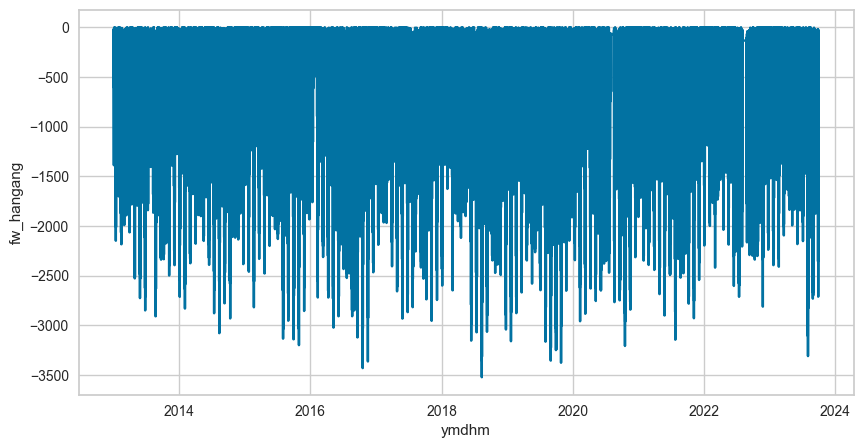

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data[data['fw_hangang']<=0].index, y=data[data['fw_hangang']<=0]['fw_hangang'], ax=ax)
plt.show();

In [ ]:
data['fw_hangang'] = data['fw_hangang'].abs()

## wl_gwangin(광진대교 수위)

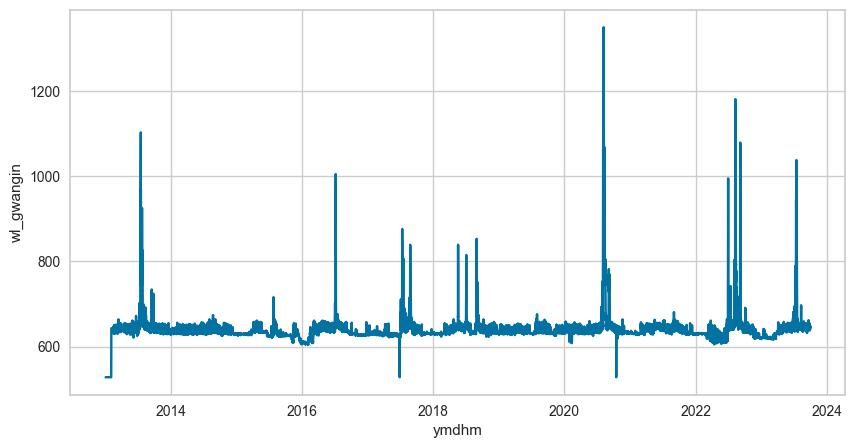

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['wl_gwangin'], ax=ax)
plt.show();

In [ ]:
data[data['wl_gwangin']<=528][['wl_jamsu','wl_gwangin']]
data.loc[data['wl_gwangin'] <= 528, 'wl_gwangin'] = np.nan;

## fw_gwangin(광진대교 유량)

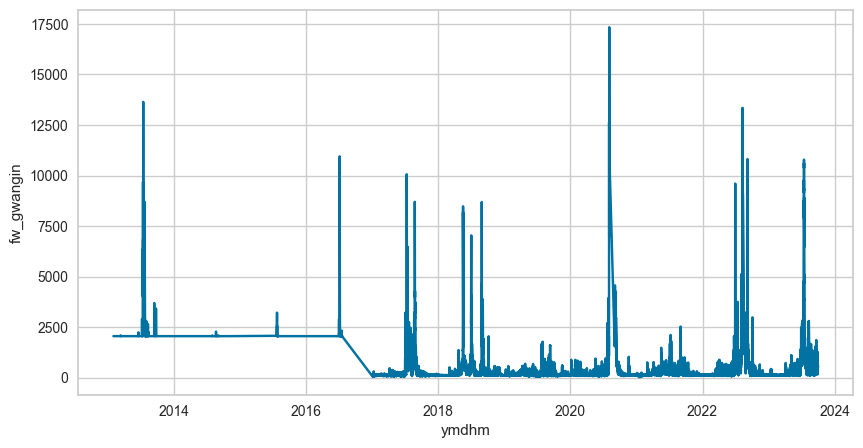

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['fw_gwangin'], ax=ax)
plt.show();

In [ ]:
data.drop('fw_gwangin',inplace=True, axis=1)

## wl_paldang(팔당대교 수위)

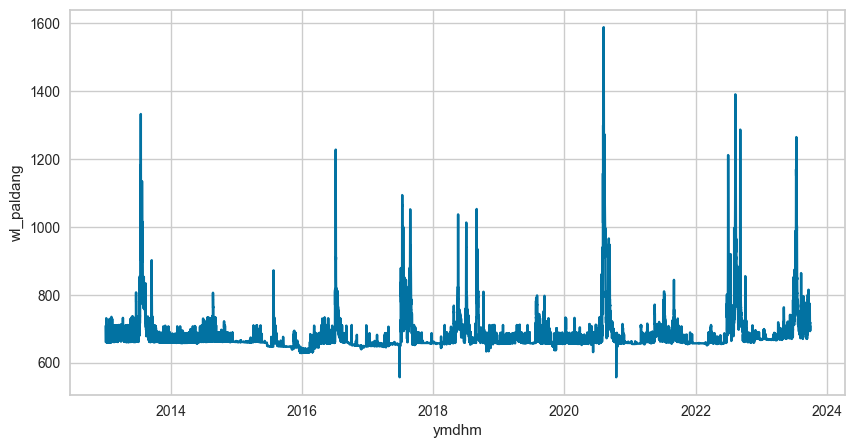

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['wl_paldang'], ax=ax)
plt.show();

In [ ]:
data[data['wl_paldang']<=557][['wl_jamsu','wl_paldang']]
data.loc[data['wl_paldang'] <= 557, 'wl_paldang'] = np.nan;

## fw_paldang(팔당대교 유량)

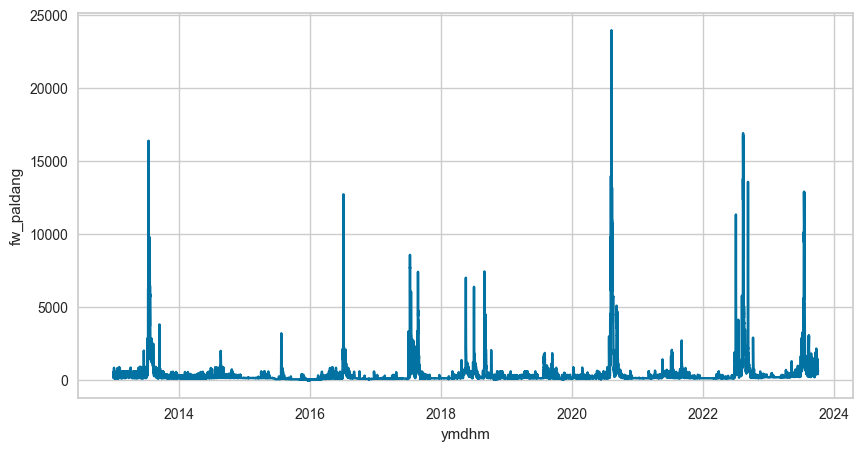

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['fw_paldang'], ax=ax)
plt.show();

## wl_jungnang(중랑교 수위)

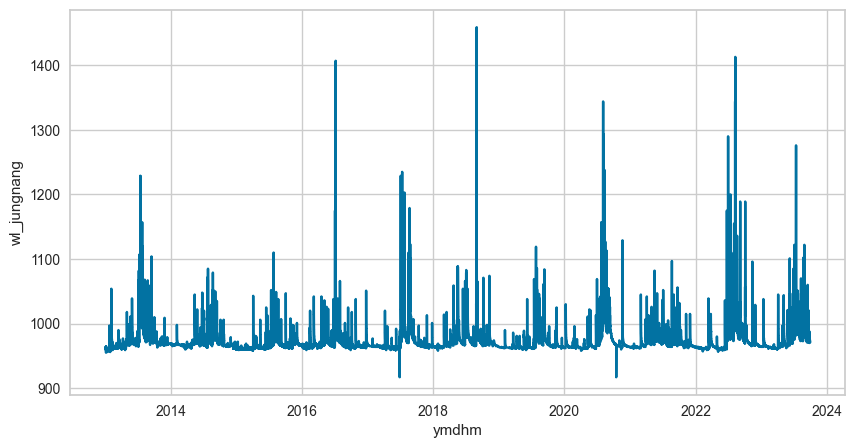

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['wl_jungnang'], ax=ax)
plt.show();

In [ ]:
data[data['wl_jungnang']<=917][['wl_jamsu','wl_jungnang']]
data.loc[data['wl_jungnang'] <= 917, 'wl_jungnang'] = np.nan;

## fw_jungnang(중랑교 유량)

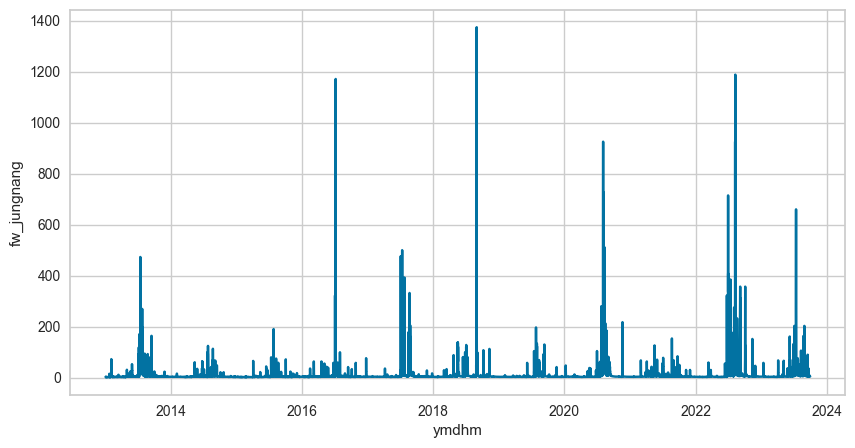

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['fw_jungnang'], ax=ax)
plt.show();

## wl_jeollyuri

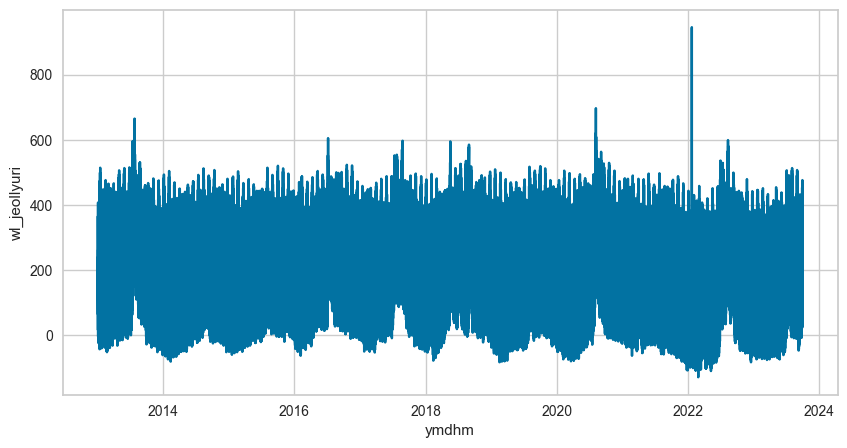

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['wl_jeollyuri'], ax=ax)
plt.show();

In [ ]:
data.loc[data['wl_jeollyuri'] <= 0, 'wl_jeollyuri'] = np.nan;

## fw_jeollyuri(전류리 유량)

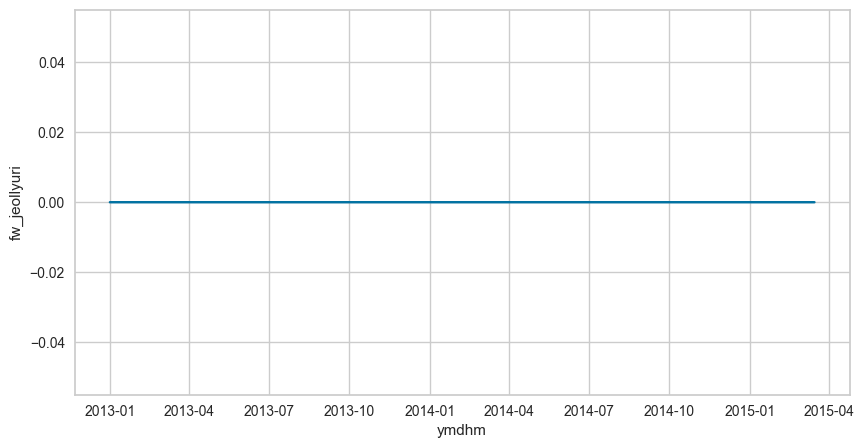

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['fw_jeollyuri'], ax=ax)
plt.show();

In [ ]:
data.drop(['fw_jeollyuri'],axis=1,inplace=True)

## swl(팔당댐 수위)

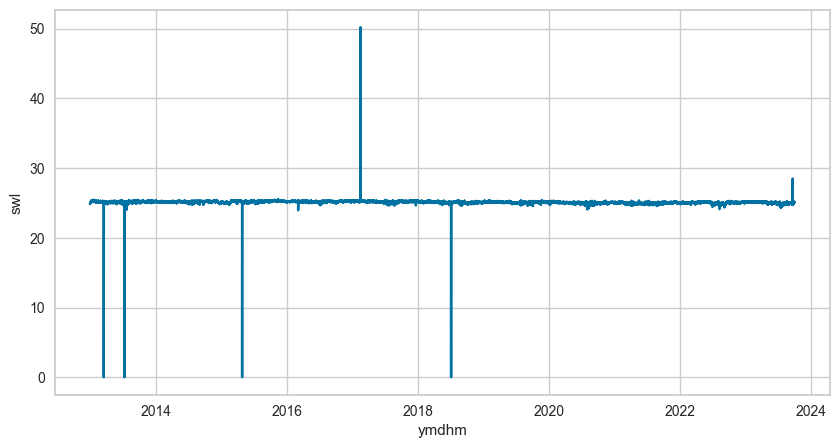

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['swl'], ax=ax)
plt.show();

In [ ]:
data.loc[(data['swl'] <= 20) | (data['swl'] > 27), 'swl'] = np.nan

## inf(팔당댐 유입량)

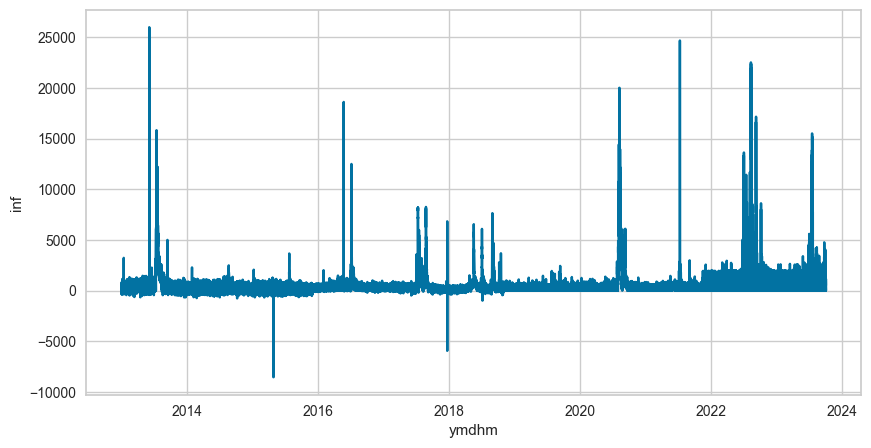

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['inf'], ax=ax)
plt.show();

In [ ]:
data.loc[data['inf'] < 0, 'inf'] = np.nan

## sfw(팔당댐 저수량)

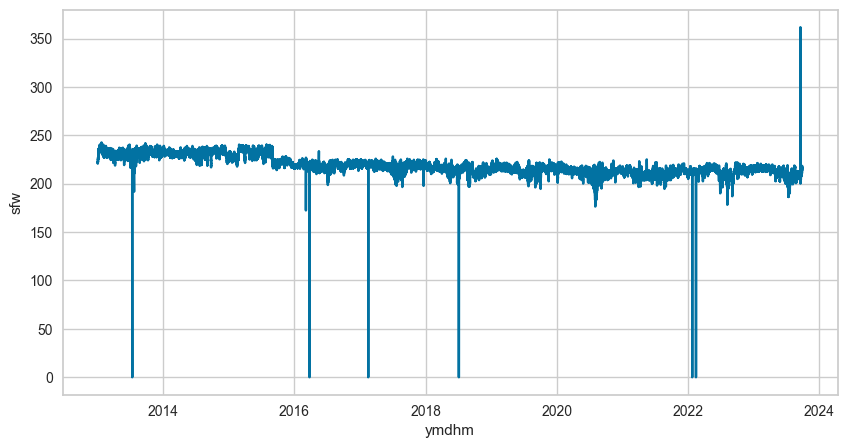

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['sfw'], ax=ax)
plt.show();

In [ ]:
data.loc[data['sfw'] < 170, 'sfw'] = np.nan
data.loc[data['sfw'] > 300, 'sfw'] = np.nan

## ecpc(팔당댐 공용량량)

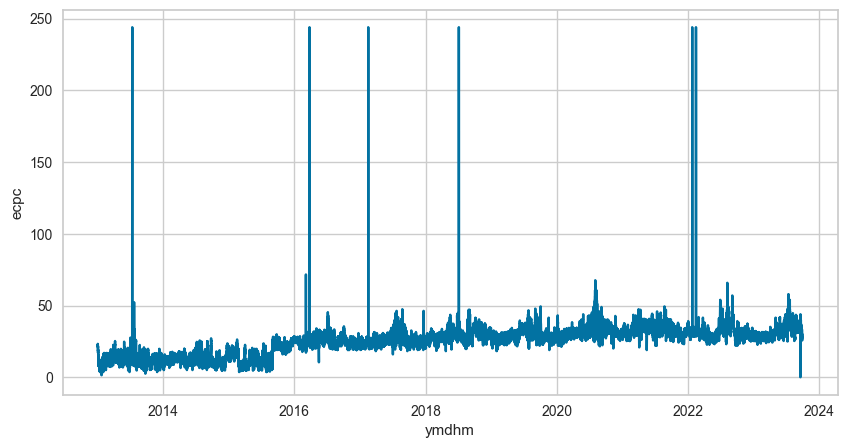

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['ecpc'], ax=ax)
plt.show();

In [ ]:
data.loc[data['ecpc'] > 80, 'ecpc'] = np.nan

## tototf(팔당댐 방류량)

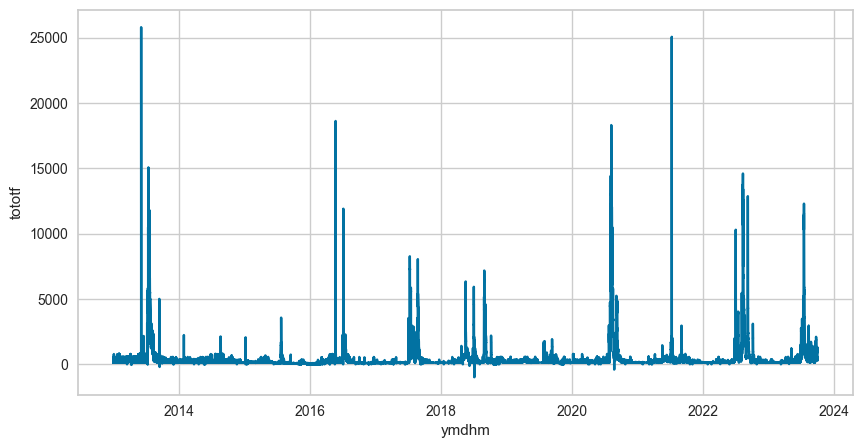

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['tototf'], ax=ax)
plt.show();

In [ ]:
data.loc[data['tototf'] < 0, 'tototf'] = np.nan

## rf_zingwan(진관교 강수량)

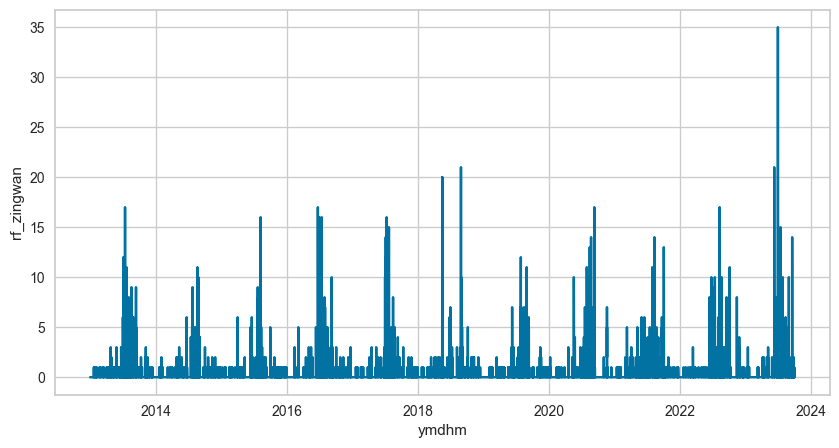

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['rf_zingwan'], ax=ax)
plt.show();

## rf_daegog(대곡교 강수량)

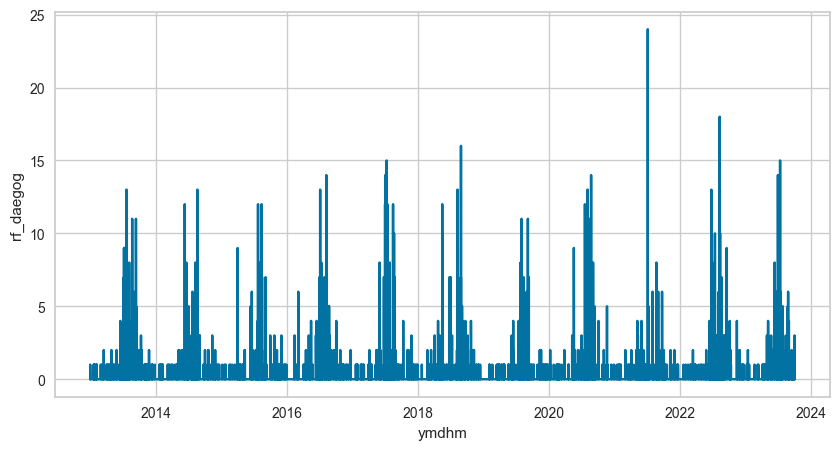

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['rf_daegog'], ax=ax)
plt.show();

## rf_songjeong(송정동 강수량)

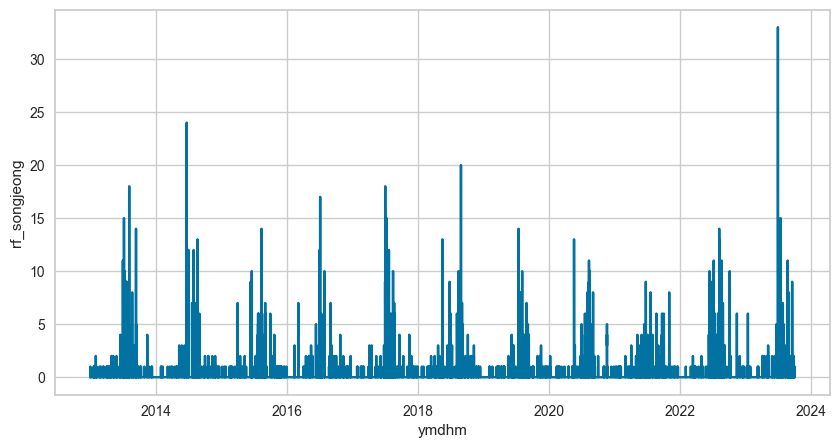

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['rf_songjeong'], ax=ax)
plt.show();

## tide_level(강화대교 조위)

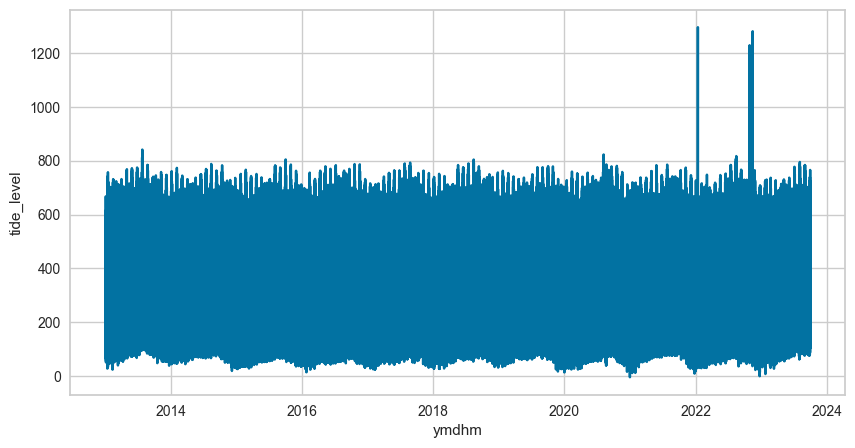

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=data.index, y=data['tide_level'], ax=ax)
plt.show();

In [ ]:
data.loc[data['tide_level'] > 900, 'tide_level'] = np.nan

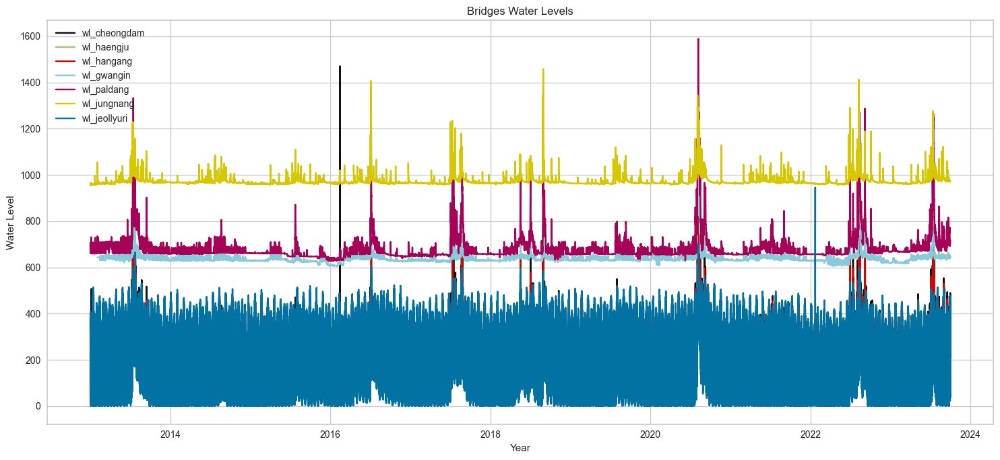

In [ ]:
bridges_wl = ['wl_cheongdam', 'wl_haengju', 'wl_hangang', 'wl_gwangin', 'wl_paldang', 'wl_jungnang','wl_jeollyuri']
colors = ['k', 'g', 'r', 'c', 'm', 'y', 'b']

plt.figure(figsize=(15, 7))

for i, bridge in enumerate(bridges_wl):
    plt.plot(data.index, data[bridge], label=bridge, color=colors[i])

plt.title('Bridges Water Levels')
plt.xlabel('Year')
plt.ylabel('Water Level')
plt.legend(loc='upper left')
plt.grid(True)
plt.tight_layout()
plt.show();


In [ ]:
# 잠수교 수위의 변화에 대한 컬럼을 추가(이전과 현재 잠수교 수위의 차이=변화량)
data['wl_jamsu_rate'] = data['wl_jamsu'].diff()

# 위 eda들을 통해 시간에 따른 수위변화가 영향이 있을 것이라 생각
data['hour'] = data.index.hour
data['month'] = data.index.month

data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 565200 entries, 2013-01-01 00:00:00 to 2023-09-30 23:50:00
Data columns (total 25 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   wl_jamsu       565141 non-null  float64
 1   wl_cheongdam   564873 non-null  float64
 2   fw_cheongdam   499874 non-null  float64
 3   wl_haengju     564634 non-null  float64
 4   fw_haengju     564939 non-null  float64
 5   wl_hangang     565141 non-null  float64
 6   fw_hangang     561917 non-null  float64
 7   wl_gwangin     560677 non-null  float64
 8   wl_paldang     565141 non-null  float64
 9   fw_paldang     565140 non-null  float64
 10  wl_jungnang    565141 non-null  float64
 11  fw_jungnang    565141 non-null  float64
 12  wl_jeollyuri   527995 non-null  float64
 13  swl            562205 non-null  float64
 14  inf            546543 non-null  float64
 15  sfw            562205 non-null  float64
 16  ecpc           562206 non-null  float64


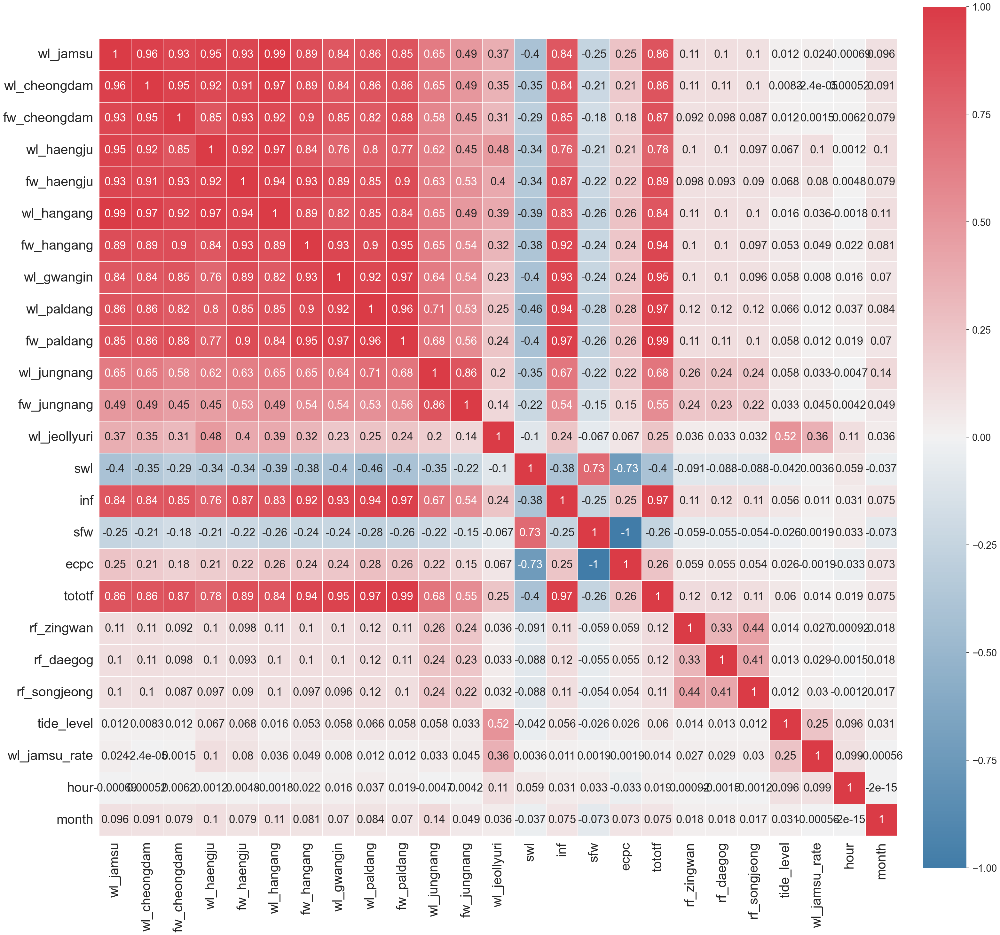

In [ ]:
corr = data.corr()
sns.set(font_scale=2)
cols=[i for i in data.columns]
fig, ax = plt.subplots(figsize=(35,35))
cmap = sns.diverging_palette(240, 10, as_cmap=True)
heatmap = sns.heatmap(corr, vmax=1, linewidths=0.1, square=True, annot=True, cmap=cmap, vmin=-1,
            linecolor="white",xticklabels = cols ,annot_kws = {'size':25},yticklabels = cols,
            cbar_kws={'fraction':0.05, 'pad':0.03})

heatmap.set_xticklabels(heatmap.get_xticklabels(), fontsize=30)
heatmap.set_yticklabels(heatmap.get_yticklabels(), fontsize=30,rotation=360)

plt.show();
#fig.savefig(f"image/상관계수히트맵", transparent = True,dpi=300, bbox_inches='tight');

In [ ]:
data.drop(['ecpc'],axis=1,inplace=True) # sfw와 상관관계가 -1

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 565200 entries, 2013-01-01 00:00:00 to 2023-09-30 23:50:00
Data columns (total 24 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   wl_jamsu       565141 non-null  float64
 1   wl_cheongdam   564873 non-null  float64
 2   fw_cheongdam   499874 non-null  float64
 3   wl_haengju     564634 non-null  float64
 4   fw_haengju     564939 non-null  float64
 5   wl_hangang     565141 non-null  float64
 6   fw_hangang     561917 non-null  float64
 7   wl_gwangin     560677 non-null  float64
 8   wl_paldang     565141 non-null  float64
 9   fw_paldang     565140 non-null  float64
 10  wl_jungnang    565141 non-null  float64
 11  fw_jungnang    565141 non-null  float64
 12  wl_jeollyuri   527995 non-null  float64
 13  swl            562205 non-null  float64
 14  inf            546543 non-null  float64
 15  sfw            562205 non-null  float64
 16  tototf         562222 non-null  float64


# Interpolate

In [ ]:
window_size = 3  # 이전 3개 행을 참조

for column in data.columns:
    for i in range(2, len(data)):
        if pd.isnull(data.at[data.index[i], column]):
            if i - window_size < 0:
                continue  # 이전 행이 없는 경우 처리하지 않음
            data.at[data.index[i], column] = data[column][i - window_size:i].mean()

data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 565200 entries, 2013-01-01 00:00:00 to 2023-09-30 23:50:00
Data columns (total 24 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   wl_jamsu       565200 non-null  float64
 1   wl_cheongdam   565200 non-null  float64
 2   fw_cheongdam   565200 non-null  float64
 3   wl_haengju     565200 non-null  float64
 4   fw_haengju     565200 non-null  float64
 5   wl_hangang     565200 non-null  float64
 6   fw_hangang     565200 non-null  float64
 7   wl_gwangin     560736 non-null  float64
 8   wl_paldang     565200 non-null  float64
 9   fw_paldang     565200 non-null  float64
 10  wl_jungnang    565200 non-null  float64
 11  fw_jungnang    565200 non-null  float64
 12  wl_jeollyuri   565200 non-null  float64
 13  swl            565200 non-null  float64
 14  inf            565200 non-null  float64
 15  sfw            565200 non-null  float64
 16  tototf         565200 non-null  float64


In [ ]:
data.to_csv("../data/ppd_data.csv")

# preprocessed Data Load

In [ ]:
ppd_data=pd.read_csv('../data/ppd_data.csv')
ppd_data.set_index("ymdhm",inplace=True)
ppd_data.index=pd.to_datetime(ppd_data.index)
ppd_data['wl_jamsu-origin']=ppd_data['wl_jamsu'].copy()

answer=pd.read_csv("../data/2023_answer.csv")
answer['ymdhm']=pd.to_datetime(answer['ymdhm'])
answer.set_index('ymdhm',inplace=True)

# Baseline model

## test 1

In [ ]:
full_data= prepare_datasets_all(ppd_data, 2013, 2022, 10)
train_full=pd.concat([full_data[0],full_data[1]],axis=1)
test_full=pd.concat([full_data[2],full_data[3]],axis=1)

In [ ]:
test_1 = setup(data=train_full, test_data = test_full, target='wl_jamsu', 
                fold_strategy = 'kfold',fold=5, data_split_shuffle=True, 
                log_experiment = 'wandb', experiment_name= 'Test_1', log_plots=True, log_data=True,
                transformation=False, session_id=624, use_gpu=True, verbose=False)

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 2, number of used features: 0
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 3060 Ti, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 16 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Warning] GPU acceleration is disabled because no non-trivial dense features can be found
[LightGBM] [Info] Start training from score 0.500000
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no mo

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: bae951753. Use `wandb login --relogin` to force relogin


In [ ]:
res_1 = compare_models(include = ['lightgbm','xgboost','catboost','rf'], sort='rmse')
res_1

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.9278,16.2400,2.8140,0.9968,0.0055,0.0028,0.9800
rf,Random Forest Regressor,0.8797,17.8598,2.9573,0.9965,0.0059,0.0027,29.7380
xgboost,Extreme Gradient Boosting,1.4079,64.0421,5.7178,0.9869,0.0091,0.0035,0.7540
catboost,CatBoost Regressor,3.0429,248.6343,12.6288,0.9421,0.0213,0.0074,4.3500


LGBMRegressor(device='gpu', n_jobs=-1, random_state=624)

In [ ]:
model_1 = create_model('lightgbm')
model_1_tuned = tune_model(model_1,choose_better = True,search_library = 'optuna',early_stopping= True, verbose=False,tuner_verbose=False)
evaluate_model(model_1_tuned)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,0.8658,2.6464,1.6268,0.9990,0.0050,0.0027
1,0.7462,1.5987,1.2644,0.9989,0.0042,0.0025
2,0.7952,1.8904,1.3749,0.9991,0.0043,0.0026
3,0.6615,1.4999,1.2247,0.9991,0.0037,0.0021
4,1.5695,73.5572,8.5766,0.9879,0.0099,0.0038
Mean,0.9276,16.2385,2.8135,0.9968,0.0055,0.0028
Std,0.3277,28.6622,2.8849,0.0044,0.0023,0.0006


[LightGBM] [Warning] feature_fraction is set=0.41262566008218693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41262566008218693
[LightGBM] [Warning] bagging_fraction is set=0.6790156422217426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6790156422217426
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.41262566008218693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41262566008218693
[LightGBM] [Warning] bagging_fraction is set=0.6790156422217426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6790156422217426
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 4722
[LightGBM] [Info] Number of data points in the train set: 378661, number of used features: 24
[Light

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

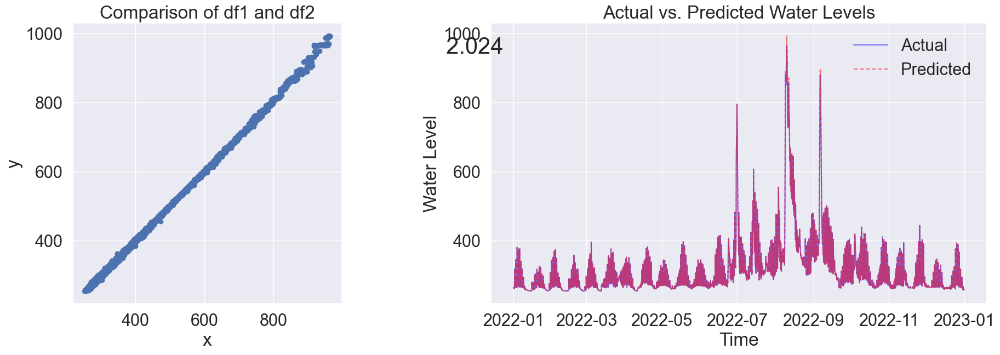

In [ ]:
pred_1=predict_model(model_1_tuned)[['wl_jamsu','prediction_label']].sort_index()
pred_1.columns=['wl_jamsu','pred_wl_jamsu']
plot_compare(pred_1,pred_1)

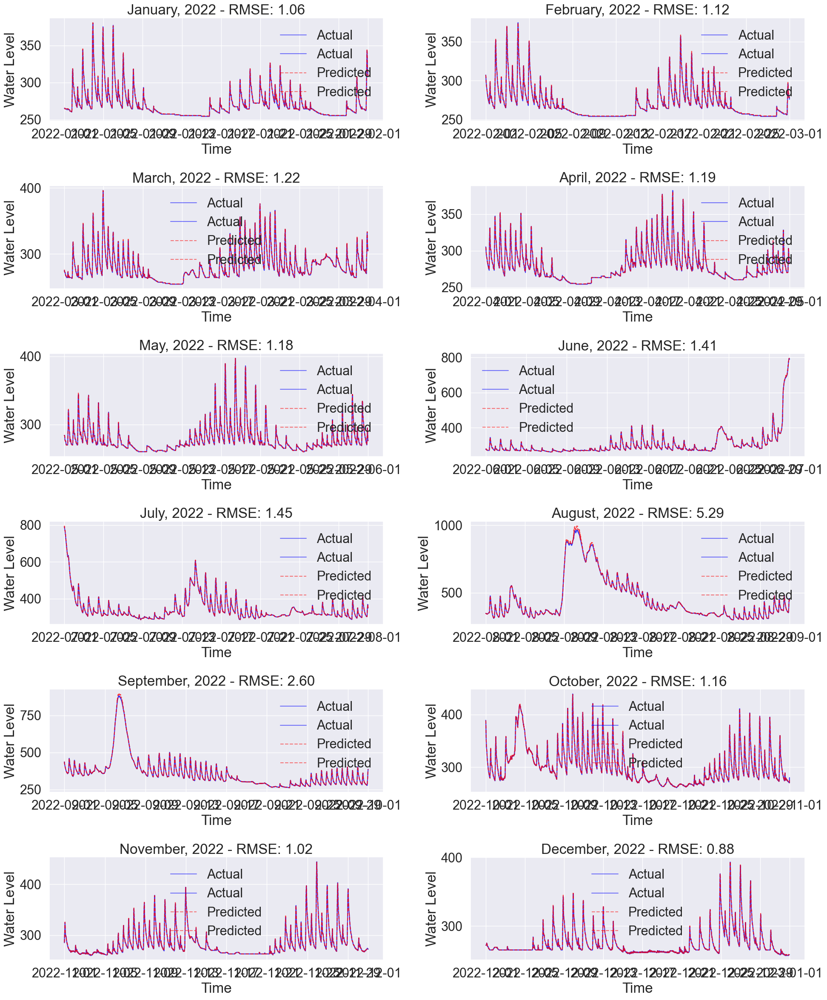

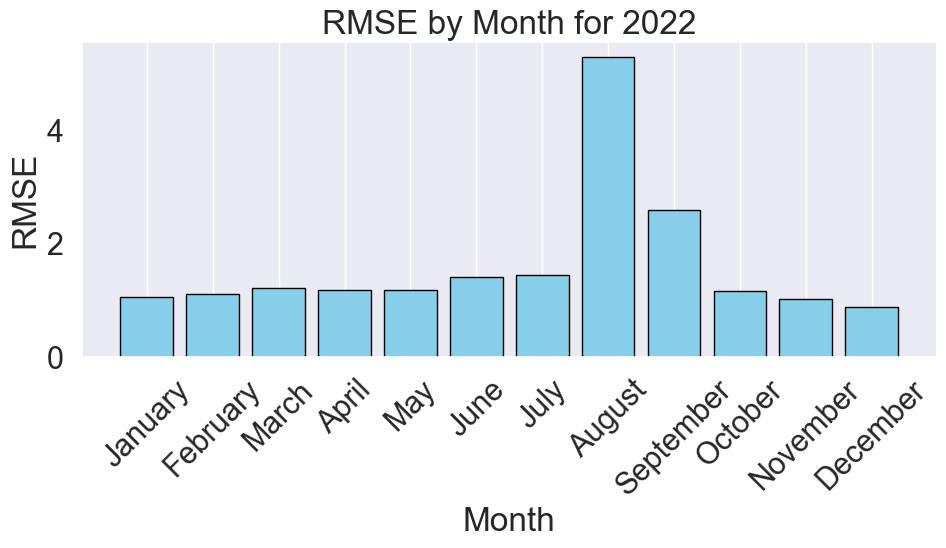

In [ ]:
plot_month(pred_1,pred_1,12)

In [ ]:
save_model(model_1_tuned, '../model/baseline_model_1')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=None),
          steps=[('numerical_imputer',
                  TransformerWrapper(include=['wl_cheongdam', 'fw_cheongdam',
                                              'wl_haengju', 'fw_haengju',
                                              'wl_hangang', 'fw_hangang',
                                              'wl_gwangin', 'wl_paldang',
                                              'fw_paldang', 'wl_jungnang',
                                              'fw_jungnang', 'wl_jeollyuri',
                                              'swl', 'inf', 'sfw', 'tototf',
                                              'rf_zingwan', 'rf_daegog',
                                              'rf_songjeong', 'tide_level',
                                              'wl_jamsu_rate', 'hour', 'month',
                                              'wl_jamsu-origin'],
                                     transformer=SimpleImputer())),
                 ('categorica

## Test 2

### test 2-1

In [ ]:
months_set_1 = [1, 2, 3, 4, 5, 6, 11, 12]
months_set_2 = [7, 8, 9, 10]

In [ ]:
sep_data1= create_datasets_part(ppd_data, 2013, 2022, 10, months_set_1,months_set_2)[0]
train_sep1=pd.concat([sep_data1[0],sep_data1[1]],axis=1)
test_sep1=pd.concat([sep_data1[2],sep_data1[3]],axis=1)

In [ ]:
test2_1 = setup(data=train_sep1, test_data = test_sep1, target='wl_jamsu', 
                fold_strategy = 'kfold',fold=5, data_split_shuffle=True, 
                log_experiment = 'wandb', experiment_name= 'Test_2-1', log_plots=True,log_data=True,
                transformation=False, session_id=624, use_gpu=True, verbose=False)

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 2, number of used features: 0
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 3060 Ti, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 16 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Warning] GPU acceleration is disabled because no non-trivial dense features can be found
[LightGBM] [Info] Start training from score 0.500000
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no mo

In [ ]:
res_2_1 = compare_models(include = ['lightgbm','xgboost','catboost','rf'], sort='rmse')
res_2_1

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.8335,10.7898,2.5172,0.9900,0.0065,0.0027,0.8700
rf,Random Forest Regressor,0.8923,11.0459,2.6591,0.9894,0.0071,0.0029,18.1300
xgboost,Extreme Gradient Boosting,0.8964,11.2491,2.7434,0.9891,0.0072,0.0029,0.5740
catboost,CatBoost Regressor,1.7511,27.4368,4.5361,0.9722,0.0116,0.0054,3.4300


LGBMRegressor(device='gpu', n_jobs=-1, random_state=624)

In [ ]:
model_2_1 = create_model('lightgbm')
model_2_1_tuned = tune_model(model_2_1,choose_better = True,search_library = 'optuna',early_stopping= True, verbose=False,tuner_verbose=False)
evaluate_model(model_2_1_tuned)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,0.9319,3.4569,1.8593,0.9953,0.0063,0.0031
1,0.6945,1.5636,1.2504,0.9978,0.0043,0.0024
2,0.7151,1.6628,1.2895,0.9975,0.0043,0.0025
3,0.9554,45.1079,6.7162,0.9621,0.0131,0.0026
4,0.8692,2.1327,1.4604,0.9972,0.0046,0.0028
Mean,0.8332,10.7848,2.5152,0.9900,0.0065,0.0027
Std,0.1088,17.1748,2.1116,0.0140,0.0034,0.0003


[LightGBM] [Warning] feature_fraction is set=0.41262566008218693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41262566008218693
[LightGBM] [Warning] bagging_fraction is set=0.6790156422217426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6790156422217426
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.41262566008218693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41262566008218693
[LightGBM] [Warning] bagging_fraction is set=0.6790156422217426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6790156422217426
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 4398
[LightGBM] [Info] Number of data points in the train set: 251135, number of used features: 24
[Light

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Light Gradient Boosting Machine,0.7547,15.2366,3.9034,0.9856,0.0074,0.0023


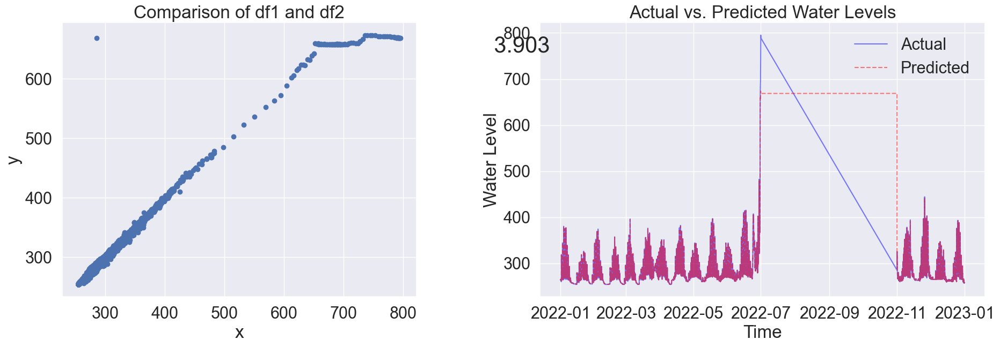

In [ ]:
pred_2_1=predict_model(model_2_1_tuned)[['wl_jamsu','prediction_label']].sort_index()
pred_2_1.columns=['wl_jamsu','pred_wl_jamsu']
plot_compare(pred_2_1,pred_2_1)

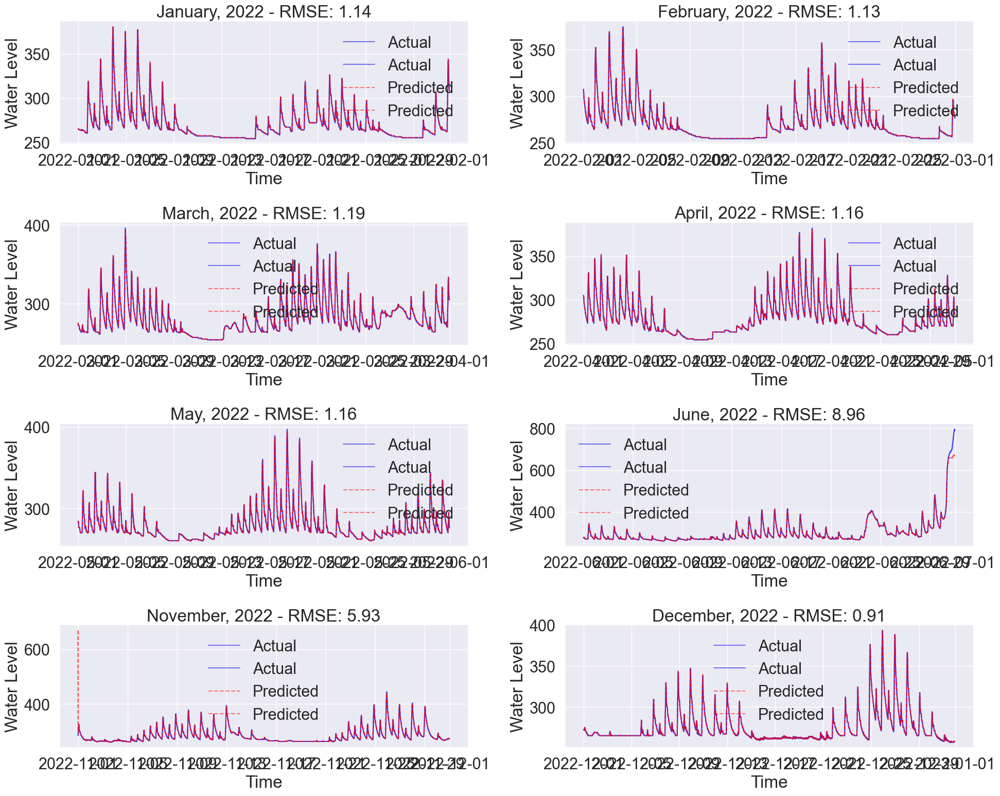

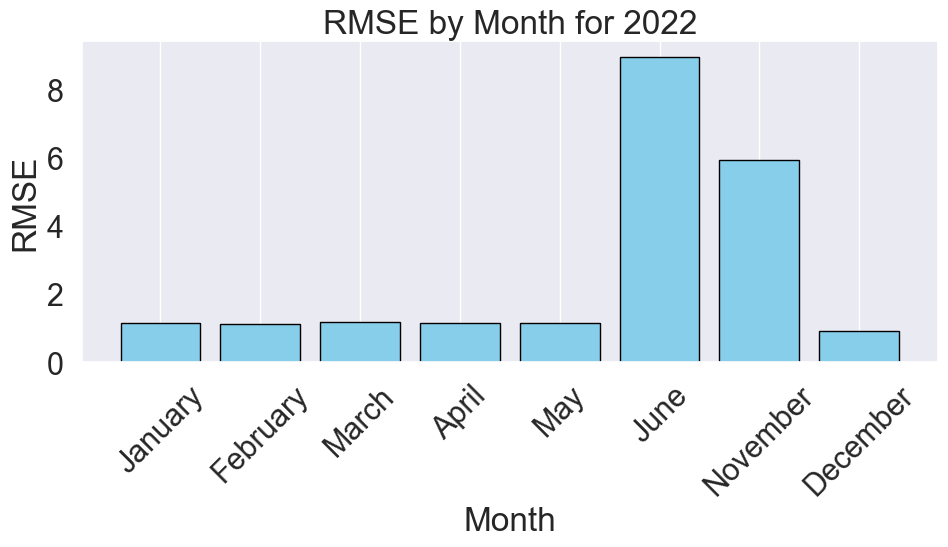

In [ ]:
plot_month(pred_2_1,pred_2_1,8)

In [ ]:
save_model(model_2_1_tuned, '../model/baseline_model_2-1')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=None),
          steps=[('numerical_imputer',
                  TransformerWrapper(include=['wl_cheongdam', 'fw_cheongdam',
                                              'wl_haengju', 'fw_haengju',
                                              'wl_hangang', 'fw_hangang',
                                              'wl_gwangin', 'wl_paldang',
                                              'fw_paldang', 'wl_jungnang',
                                              'fw_jungnang', 'wl_jeollyuri',
                                              'swl', 'inf', 'sfw', 'tototf',
                                              'rf_zingwan', 'rf_daegog',
                                              'rf_songjeong', 'tide_level',
                                              'wl_jamsu_rate', 'hour', 'month',
                                              'wl_jamsu-origin'],
                                     transformer=SimpleImputer())),
                 ('categorica

### test 2-2

In [ ]:
sep_data2= create_datasets_part(ppd_data, 2013, 2022, 10, months_set_1,months_set_2)[1]
train_sep2=pd.concat([sep_data2[0],sep_data2[1]],axis=1)
test_sep2=pd.concat([sep_data2[2],sep_data2[3]],axis=1)

In [ ]:
test2_2 = setup(data=train_sep2, test_data = test_sep2, target='wl_jamsu', 
                fold_strategy = 'kfold',fold=5, data_split_shuffle=True, 
                log_experiment = 'wandb', experiment_name= 'Test_2-2', log_plots=True,log_data=True,
                transformation=False, session_id=624, use_gpu=True, verbose=False) 

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 2, number of used features: 0
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 3060 Ti, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 16 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Warning] GPU acceleration is disabled because no non-trivial dense features can be found
[LightGBM] [Info] Start training from score 0.500000
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no mo

In [ ]:
res_2_2 = compare_models(include = ['lightgbm','xgboost','catboost','rf'], sort='rmse')
res_2_2

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lightgbm,Light Gradient Boosting Machine,1.3262,48.8252,4.3150,0.9962,0.0070,0.0034,0.7260
rf,Random Forest Regressor,1.1546,49.1349,4.3487,0.9962,0.0072,0.0030,8.9160
xgboost,Extreme Gradient Boosting,1.9813,142.3751,7.1465,0.9893,0.0106,0.0043,0.4080
catboost,CatBoost Regressor,5.1931,470.2690,16.8821,0.9513,0.0265,0.0112,2.8520


Processing:   0%|          | 0/21 [00:00<?, ?it/s]

LGBMRegressor(device='gpu', n_jobs=-1, random_state=624)

In [ ]:
model_2_2 = create_model('lightgbm')
model_2_2_tuned = tune_model(model_2_2,choose_better = True,search_library = 'optuna',early_stopping= True, verbose=False,tuner_verbose=False)
evaluate_model(model_2_2_tuned)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,0.9109,2.5196,1.5873,0.9996,0.0043,0.0026
1,0.8666,2.3525,1.5338,0.9991,0.0049,0.0028
2,1.0425,2.7958,1.6721,0.9993,0.0050,0.0032
3,0.8035,2.1810,1.4768,0.9991,0.0044,0.0025
4,3.0073,234.2434,15.3050,0.9839,0.0167,0.0057
Mean,1.3262,48.8184,4.3150,0.9962,0.0070,0.0034
Std,0.8442,92.7127,5.4954,0.0061,0.0048,0.0012


[LightGBM] [Warning] feature_fraction is set=0.41262566008218693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41262566008218693
[LightGBM] [Warning] bagging_fraction is set=0.6790156422217426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6790156422217426
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.41262566008218693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41262566008218693
[LightGBM] [Warning] bagging_fraction is set=0.6790156422217426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6790156422217426
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 4703
[LightGBM] [Info] Number of data points in the train set: 127525, number of used features: 24
[Light

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Light Gradient Boosting Machine,1.1623,6.8884,2.6246,0.9995,0.0044,0.0027


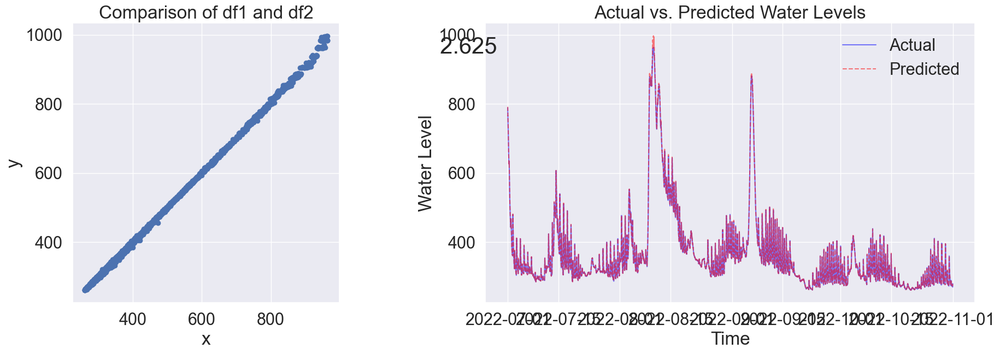

In [ ]:
pred_2_2=predict_model(model_2_2_tuned)[['wl_jamsu','prediction_label']].sort_index()
pred_2_2.columns=['wl_jamsu','pred_wl_jamsu']
plot_compare(pred_2_2,pred_2_2)

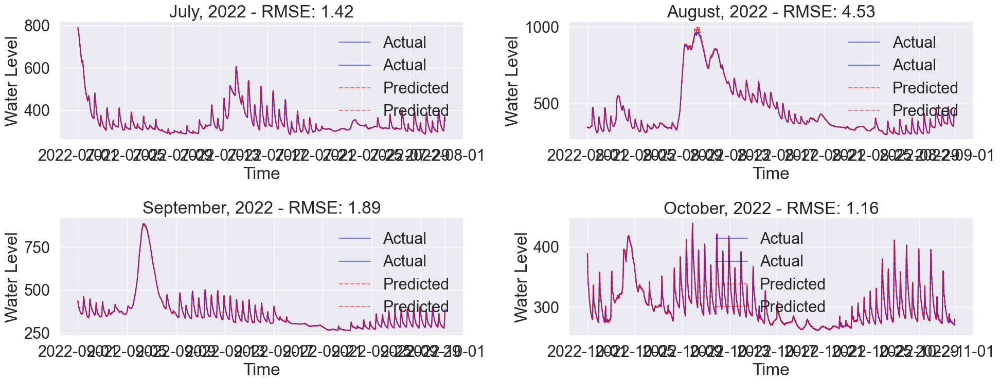

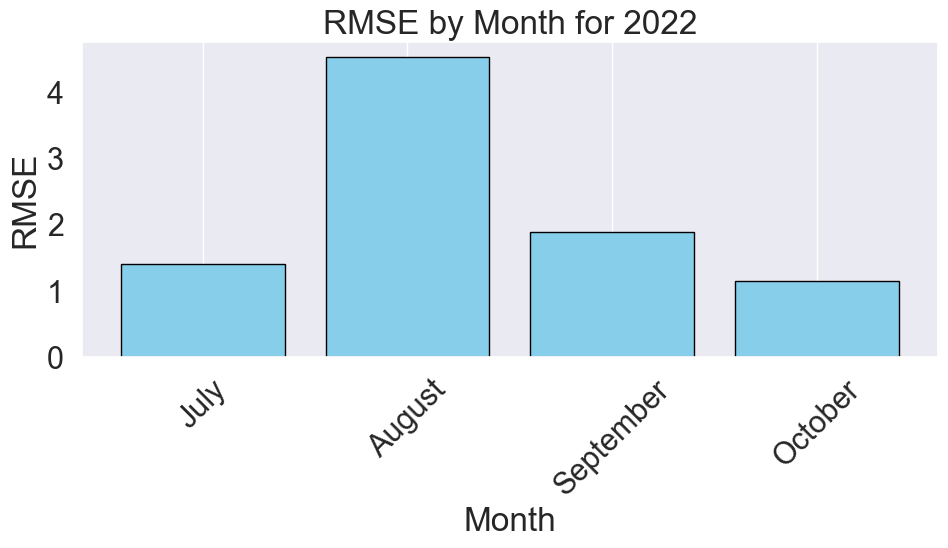

In [ ]:
plot_month(pred_2_2,pred_2_2,4)

In [ ]:
save_model(model_2_2_tuned, '../model/baseline_model_2-2')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=None),
          steps=[('numerical_imputer',
                  TransformerWrapper(include=['wl_cheongdam', 'fw_cheongdam',
                                              'wl_haengju', 'fw_haengju',
                                              'wl_hangang', 'fw_hangang',
                                              'wl_gwangin', 'wl_paldang',
                                              'fw_paldang', 'wl_jungnang',
                                              'fw_jungnang', 'wl_jeollyuri',
                                              'swl', 'inf', 'sfw', 'tototf',
                                              'rf_zingwan', 'rf_daegog',
                                              'rf_songjeong', 'tide_level',
                                              'wl_jamsu_rate', 'hour', 'month',
                                              'wl_jamsu-origin'],
                                     transformer=SimpleImputer())),
                 ('categorica

### test 2 merge

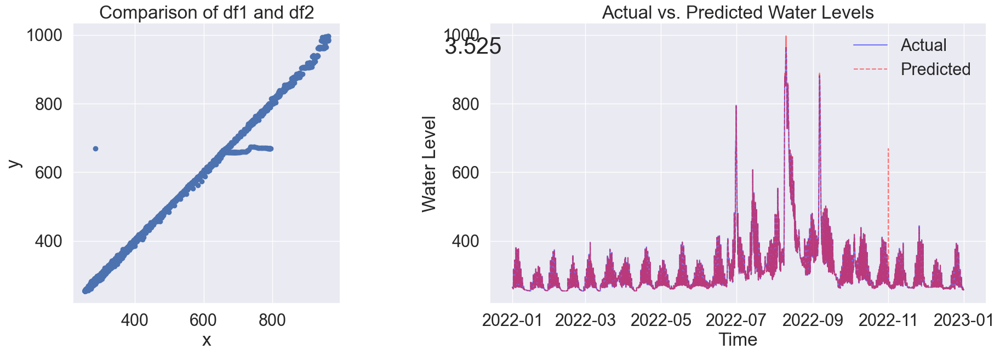

In [ ]:
pred_2 = pd.concat([pred_2_1, pred_2_2]).sort_index()
plot_compare(pred_2,pred_2)

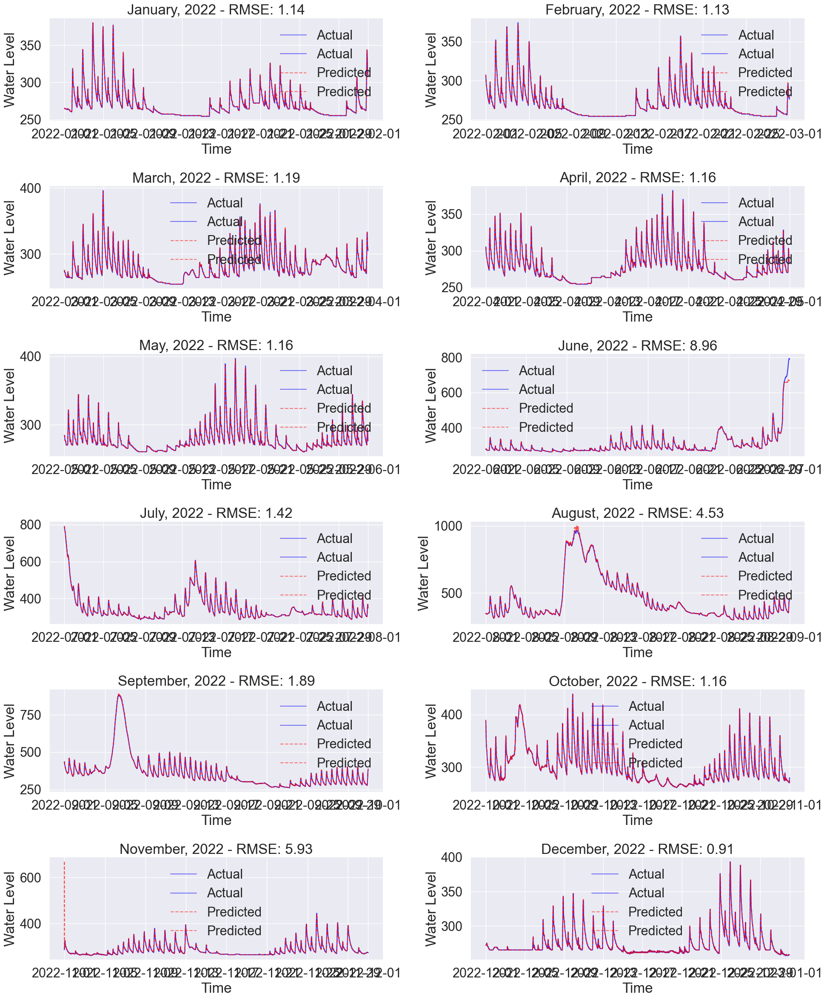

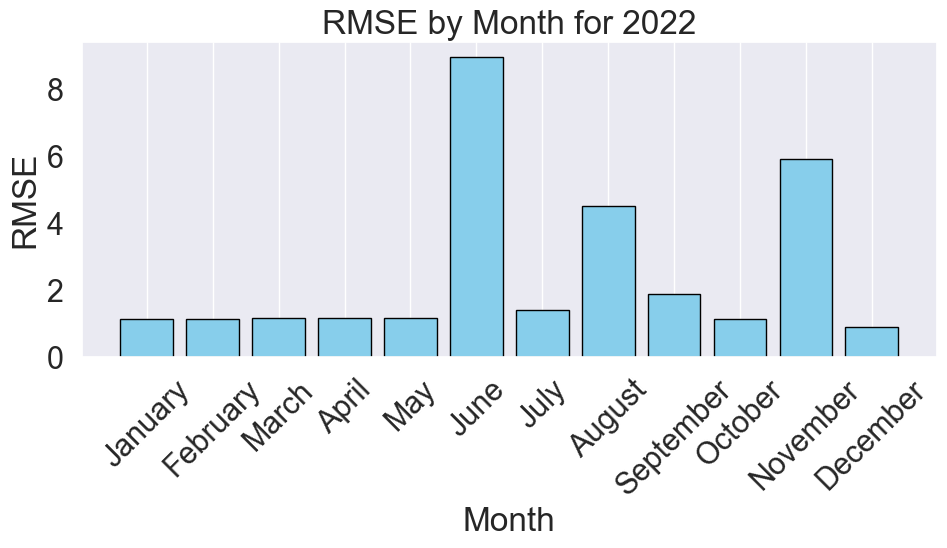

In [ ]:
plot_month(pred_2,pred_2,12)

## Test 3

In [ ]:
ppd_data2=ppd_data.drop([ 'rf_zingwan', 'rf_daegog','rf_songjeong', 'month'],axis=1)

### test 3-1

In [ ]:
full_data= prepare_datasets_all(ppd_data2, 2013, 2022, 10)
train_full=pd.concat([full_data[0],full_data[1]],axis=1)
test_full=pd.concat([full_data[2],full_data[3]],axis=1)

In [ ]:
test3_1 = setup(data=train_full, test_data = test_full, target='wl_jamsu', 
                fold_strategy = 'kfold',fold=5, data_split_shuffle=True, 
                log_experiment = 'wandb', experiment_name= 'Test_3-1', log_plots=True,log_data=True,
                transformation=False, session_id=624, use_gpu=True, verbose=False) 

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 2, number of used features: 0
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 3060 Ti, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 16 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Warning] GPU acceleration is disabled because no non-trivial dense features can be found
[LightGBM] [Info] Start training from score 0.500000
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no mo

In [ ]:
model_3_1 = create_model('lightgbm')
model_3_1_tuned = tune_model(model_3_1,choose_better = True,search_library = 'optuna',early_stopping= True, verbose=False,tuner_verbose=False)
evaluate_model(model_3_1_tuned)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,0.8748,2.6779,1.6364,0.9990,0.0050,0.0028
1,0.7393,1.5905,1.2611,0.9989,0.0042,0.0025
2,0.7881,1.8697,1.3674,0.9992,0.0043,0.0026
3,0.6558,1.4834,1.2179,0.9991,0.0037,0.0021
4,1.5348,72.9745,8.5425,0.9880,0.0099,0.0037
Mean,0.9186,16.1192,2.8051,0.9968,0.0054,0.0027
Std,0.3162,28.4307,2.8724,0.0044,0.0023,0.0005


[LightGBM] [Warning] feature_fraction is set=0.41262566008218693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41262566008218693
[LightGBM] [Warning] bagging_fraction is set=0.6790156422217426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6790156422217426
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.41262566008218693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41262566008218693
[LightGBM] [Warning] bagging_fraction is set=0.6790156422217426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6790156422217426
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 4664
[LightGBM] [Info] Number of data points in the train set: 378661, number of used features: 20
[Light

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

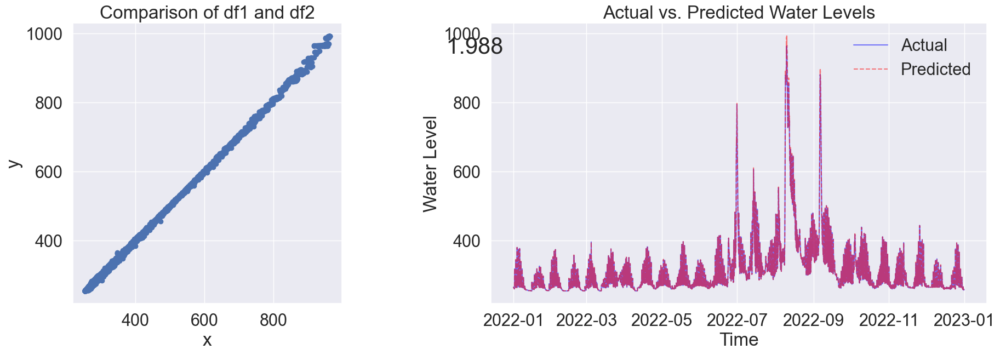

In [ ]:
pred_3_1=predict_model(model_3_1_tuned)[['wl_jamsu','prediction_label']].sort_index()
pred_3_1.columns=['wl_jamsu','pred_wl_jamsu']
plot_compare(pred_3_1,pred_3_1)

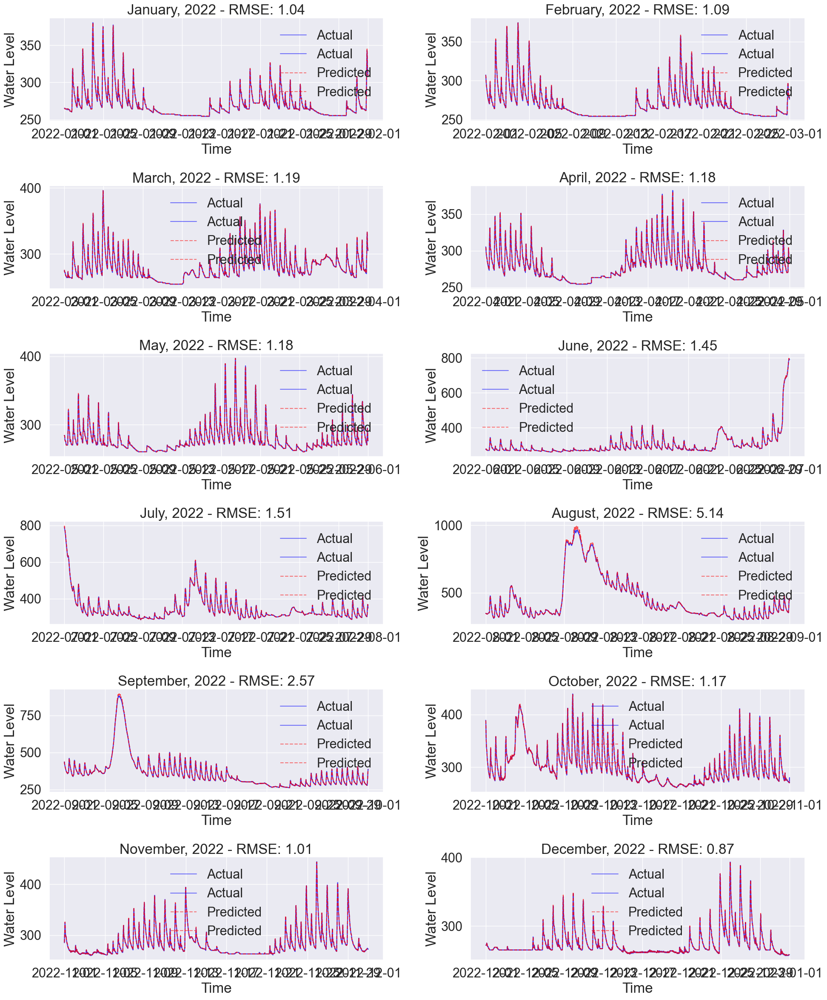

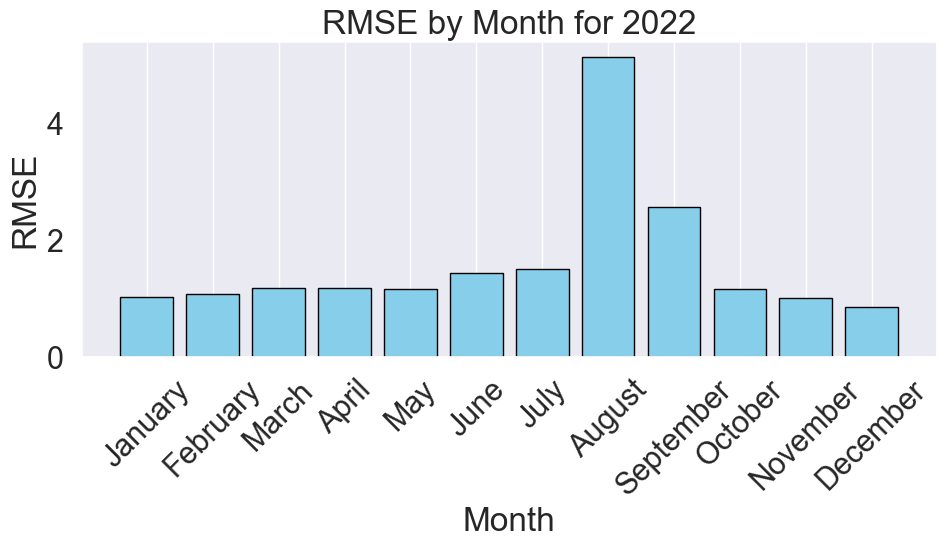

In [ ]:
plot_month(pred_3_1,pred_3_1,12)

In [ ]:
save_model(model_3_1_tuned, '../model/baseline_model_3-1')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=None),
          steps=[('numerical_imputer',
                  TransformerWrapper(include=['wl_cheongdam', 'fw_cheongdam',
                                              'wl_haengju', 'fw_haengju',
                                              'wl_hangang', 'fw_hangang',
                                              'wl_gwangin', 'wl_paldang',
                                              'fw_paldang', 'wl_jungnang',
                                              'fw_jungnang', 'wl_jeollyuri',
                                              'swl', 'inf', 'sfw', 'tototf',
                                              'tide_level', 'wl_jamsu_rate',
                                              'hour', 'wl_jamsu-origin'],
                                     transformer=SimpleImputer())),
                 ('categorical_imputer',
                  TransformerWrapper(include=[],
                                     transformer=SimpleImputer(strategy='most_frequ

### test 3-2

In [ ]:
months_set_1 = [1, 2, 3, 4, 5, 6, 11, 12]
months_set_2 = [7, 8, 9, 10]

In [ ]:
sep_data1= create_datasets_by_part(ppd_data2, 2013, 2022, 10, months_set_1,months_set_2)[0]
train_sep1=pd.concat([sep_data1[0],sep_data1[1]],axis=1)
test_sep1=pd.concat([sep_data1[2],sep_data1[3]],axis=1)

In [ ]:
test3_2 = setup(data=train_sep1, test_data = test_sep1, target='wl_jamsu', 
                fold_strategy = 'kfold',fold=5, data_split_shuffle=True, 
                log_experiment = 'wandb', experiment_name= 'Test_3-2', log_plots=True,log_data=True,
                transformation=False, session_id=624, use_gpu=True, verbose=False) 

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 2, number of used features: 0
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 3060 Ti, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 16 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Warning] GPU acceleration is disabled because no non-trivial dense features can be found
[LightGBM] [Info] Start training from score 0.500000
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no mo

In [ ]:
model_3_2 = create_model('lightgbm')
model_3_2_tuned = tune_model(model_3_2,choose_better = True,search_library = 'optuna',early_stopping= True, verbose=False,tuner_verbose=False)
evaluate_model(model_3_2_tuned)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,0.9280,3.3817,1.8390,0.9954,0.0062,0.0031
1,0.6938,1.5691,1.2526,0.9978,0.0043,0.0024
2,0.7122,1.6444,1.2823,0.9976,0.0043,0.0025
3,0.9536,44.6215,6.6799,0.9625,0.0130,0.0026
4,0.8366,2.0633,1.4364,0.9973,0.0045,0.0027
Mean,0.8248,10.6560,2.4981,0.9901,0.0065,0.0027
Std,0.1070,16.9952,2.1014,0.0138,0.0034,0.0002


[LightGBM] [Warning] feature_fraction is set=0.41262566008218693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41262566008218693
[LightGBM] [Warning] bagging_fraction is set=0.6790156422217426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6790156422217426
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.41262566008218693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41262566008218693
[LightGBM] [Warning] bagging_fraction is set=0.6790156422217426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6790156422217426
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 4356
[LightGBM] [Info] Number of data points in the train set: 251135, number of used features: 20
[Light

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Light Gradient Boosting Machine,0.7444,15.2344,3.9031,0.9856,0.0074,0.0023


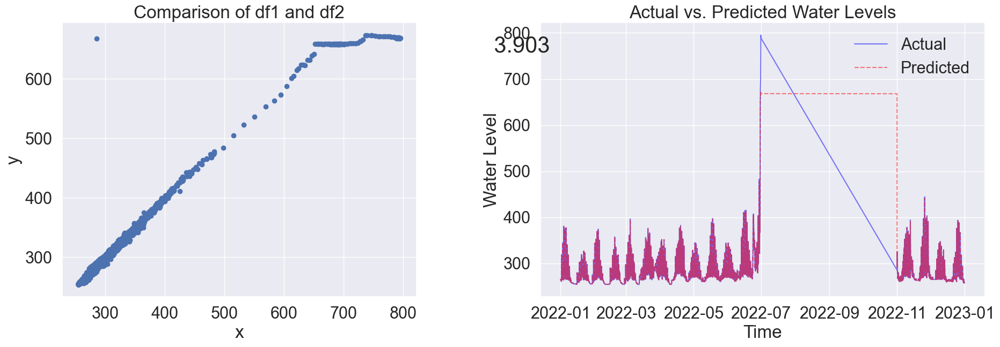

In [ ]:
pred_3_2=predict_model(model_3_2_tuned)[['wl_jamsu','prediction_label']].sort_index()
pred_3_2.columns=['wl_jamsu','pred_wl_jamsu']
plot_compare(pred_3_2,pred_3_2)

In [ ]:
save_model(model_3_2_tuned, '../model/baseline_model_3-2')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=None),
          steps=[('numerical_imputer',
                  TransformerWrapper(include=['wl_cheongdam', 'fw_cheongdam',
                                              'wl_haengju', 'fw_haengju',
                                              'wl_hangang', 'fw_hangang',
                                              'wl_gwangin', 'wl_paldang',
                                              'fw_paldang', 'wl_jungnang',
                                              'fw_jungnang', 'wl_jeollyuri',
                                              'swl', 'inf', 'sfw', 'tototf',
                                              'tide_level', 'wl_jamsu_rate',
                                              'hour', 'wl_jamsu-origin'],
                                     transformer=SimpleImputer())),
                 ('categorical_imputer',
                  TransformerWrapper(include=[],
                                     transformer=SimpleImputer(strategy='most_frequ

### test 3-3

In [ ]:
sep_data2= create_datasets_part(ppd_data2, 2013, 2022, 10 ,months_set_1,months_set_2)[1]
train_sep2=pd.concat([sep_data2[0],sep_data2[1]],axis=1)
test_sep2=pd.concat([sep_data2[2],sep_data2[3]],axis=1)

In [ ]:
test3_3 = setup(data=train_sep2, test_data = test_sep2, target='wl_jamsu', 
                fold_strategy = 'kfold',fold=5, data_split_shuffle=True, 
                log_experiment = 'wandb', experiment_name= 'Test_3-3', log_plots=True,log_data=True,
                transformation=False, session_id=624, use_gpu=True, verbose=False) 

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 2, number of used features: 0
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 3060 Ti, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 16 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Warning] GPU acceleration is disabled because no non-trivial dense features can be found
[LightGBM] [Info] Start training from score 0.500000
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no mo

In [ ]:
model_3_3 = create_model('lightgbm')
model_3_3_tuned = tune_model(model_3_3,choose_better = True,search_library = 'optuna',early_stopping= True, verbose=False,tuner_verbose=False)
evaluate_model(model_3_3_tuned)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,0.9123,2.5651,1.6016,0.9996,0.0043,0.0026
1,0.8611,2.3238,1.5244,0.9992,0.0049,0.0028
2,1.0392,2.8028,1.6741,0.9993,0.0050,0.0032
3,0.7866,2.1273,1.4585,0.9991,0.0043,0.0024
4,2.8973,231.7362,15.2229,0.9841,0.0165,0.0054
Mean,1.2993,48.3110,4.2963,0.9962,0.0070,0.0033
Std,0.8032,91.7129,5.4638,0.0061,0.0048,0.0011


[LightGBM] [Warning] feature_fraction is set=0.41262566008218693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41262566008218693
[LightGBM] [Warning] bagging_fraction is set=0.6790156422217426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6790156422217426
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.41262566008218693, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.41262566008218693
[LightGBM] [Warning] bagging_fraction is set=0.6790156422217426, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6790156422217426
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 4651
[LightGBM] [Info] Number of data points in the train set: 127525, number of used features: 20
[Light

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Light Gradient Boosting Machine,1.1661,6.9101,2.6287,0.9995,0.0044,0.0027


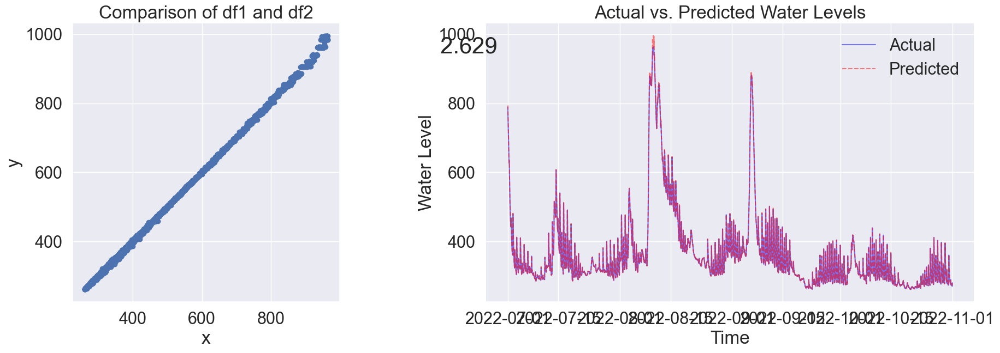

In [ ]:
pred_3_3=predict_model(model_3_3_tuned)[['wl_jamsu','prediction_label']].sort_index()
pred_3_3.columns=['wl_jamsu','pred_wl_jamsu']
plot_compare(pred_3_3,pred_3_3)

In [ ]:
save_model(model_3_3_tuned, '../model/baseline_model_3-3')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=None),
          steps=[('numerical_imputer',
                  TransformerWrapper(include=['wl_cheongdam', 'fw_cheongdam',
                                              'wl_haengju', 'fw_haengju',
                                              'wl_hangang', 'fw_hangang',
                                              'wl_gwangin', 'wl_paldang',
                                              'fw_paldang', 'wl_jungnang',
                                              'fw_jungnang', 'wl_jeollyuri',
                                              'swl', 'inf', 'sfw', 'tototf',
                                              'tide_level', 'wl_jamsu_rate',
                                              'hour', 'wl_jamsu-origin'],
                                     transformer=SimpleImputer())),
                 ('categorical_imputer',
                  TransformerWrapper(include=[],
                                     transformer=SimpleImputer(strategy='most_frequ

## test 3 merge

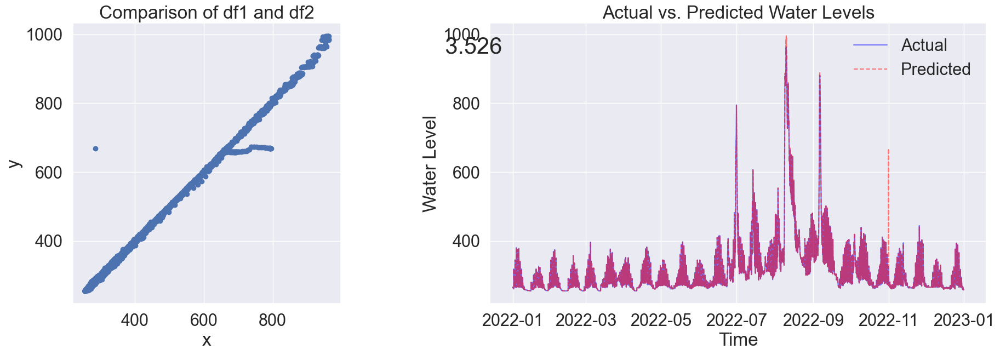

In [ ]:
pred_3 = pd.concat([pred_3_2, pred_3_3]).sort_index()
plot_compare(pred_3,pred_3)

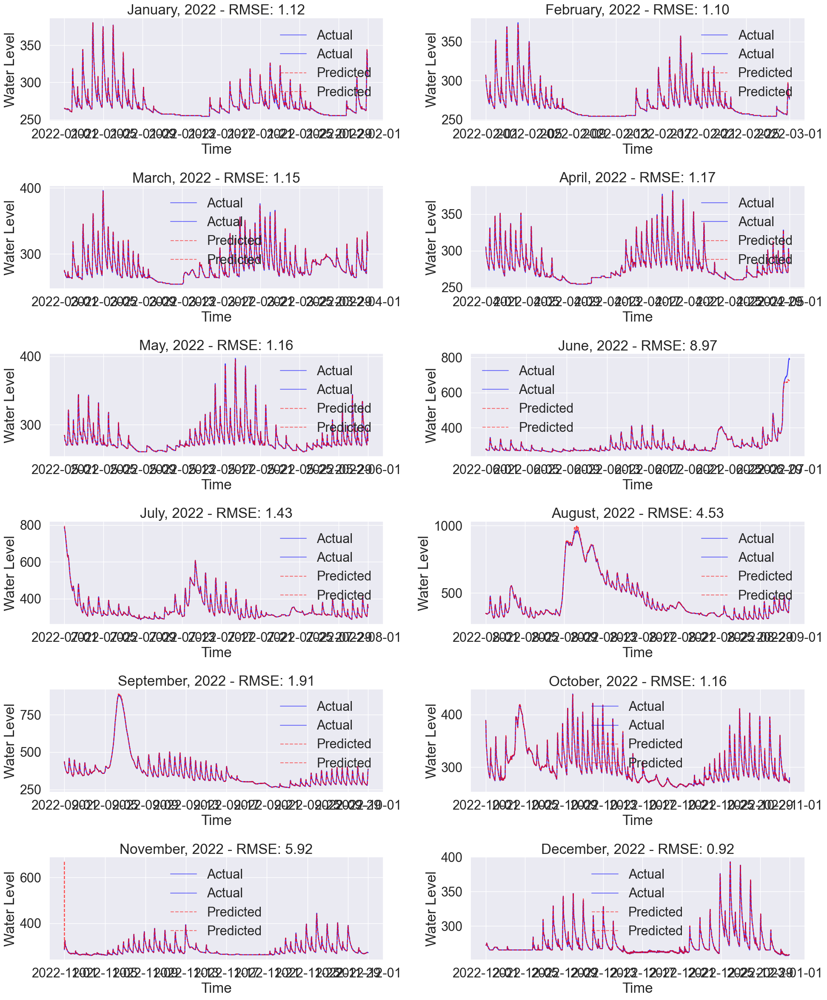

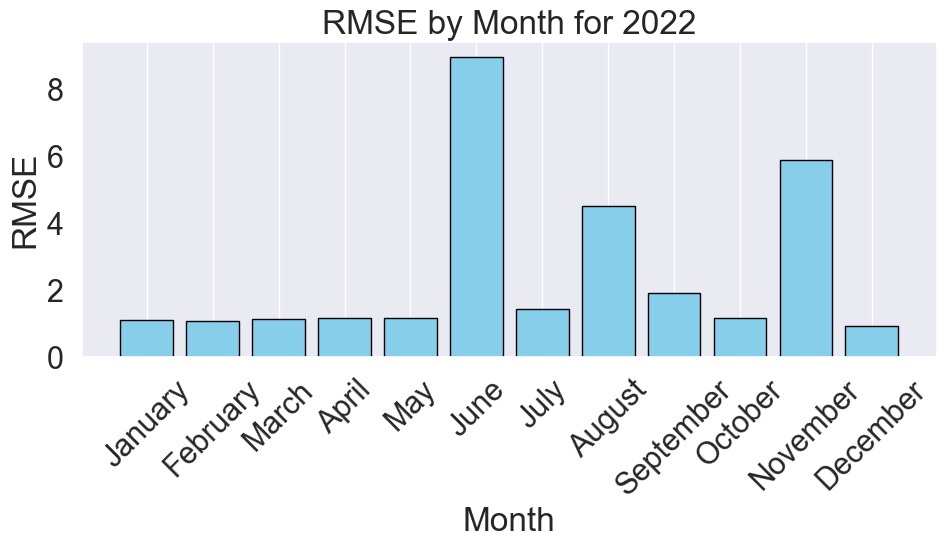

In [ ]:
plot_month(pred_3,pred_3,12)

# Final model

In [ ]:
ppd_data.columns
ppd_data2.columns

Index(['wl_jamsu', 'wl_cheongdam', 'fw_cheongdam', 'wl_haengju', 'fw_haengju',
       'wl_hangang', 'fw_hangang', 'wl_gwangin', 'wl_paldang', 'fw_paldang',
       'wl_jungnang', 'fw_jungnang', 'wl_jeollyuri', 'swl', 'inf', 'sfw',
       'tototf', 'rf_zingwan', 'rf_daegog', 'rf_songjeong', 'tide_level',
       'wl_jamsu_rate', 'hour', 'month', 'wl_jamsu-origin'],
      dtype='object')

Index(['wl_jamsu', 'wl_cheongdam', 'fw_cheongdam', 'wl_haengju', 'fw_haengju',
       'wl_hangang', 'fw_hangang', 'wl_gwangin', 'wl_paldang', 'fw_paldang',
       'wl_jungnang', 'fw_jungnang', 'wl_jeollyuri', 'swl', 'inf', 'sfw',
       'tototf', 'tide_level', 'wl_jamsu_rate', 'hour', 'wl_jamsu-origin'],
      dtype='object')

## leadtime 10

In [ ]:
leadtime_10_pred = predict_wl_level(ppd_data2, 10)
leadtime_10_pred.to_csv("../result/leadtime(10).csv")

##################################################
Leadtime 10 predict start
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 2, number of used features: 0
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 3060 Ti, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 16 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Warning] GPU acceleration is disabled because no non-trivial dense features can be found
[LightGBM] [Info] Start training from score 0.500000
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the spl

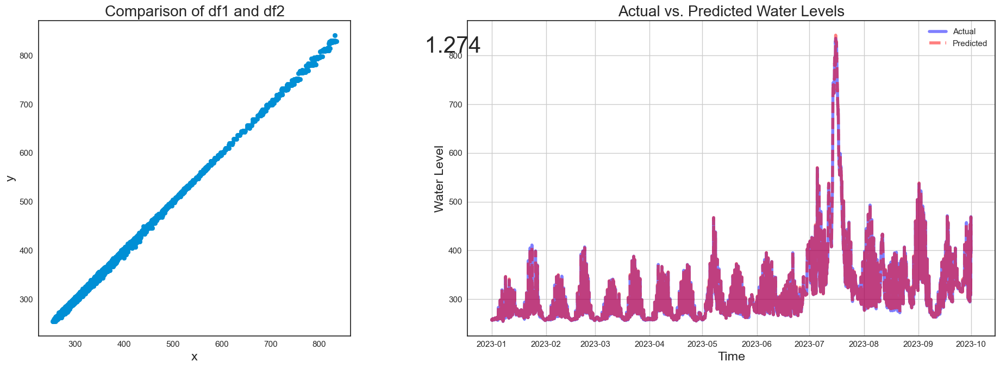

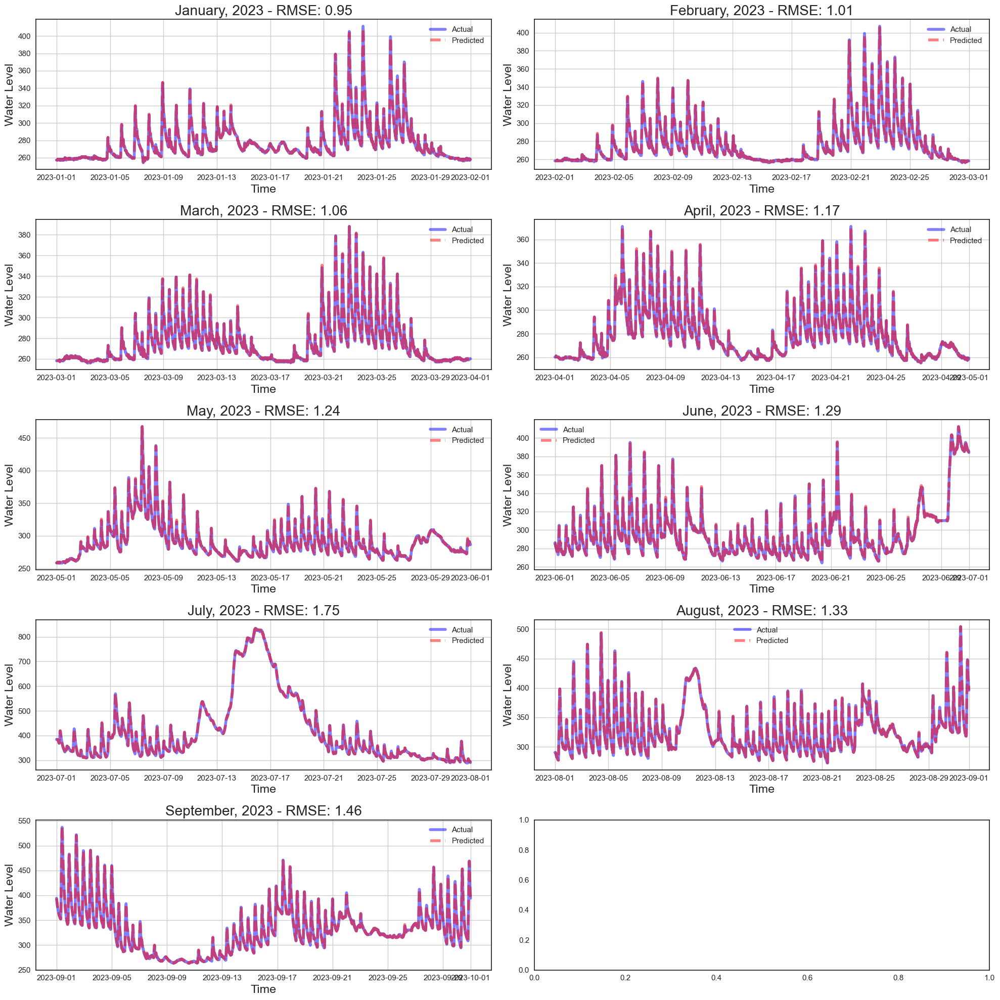

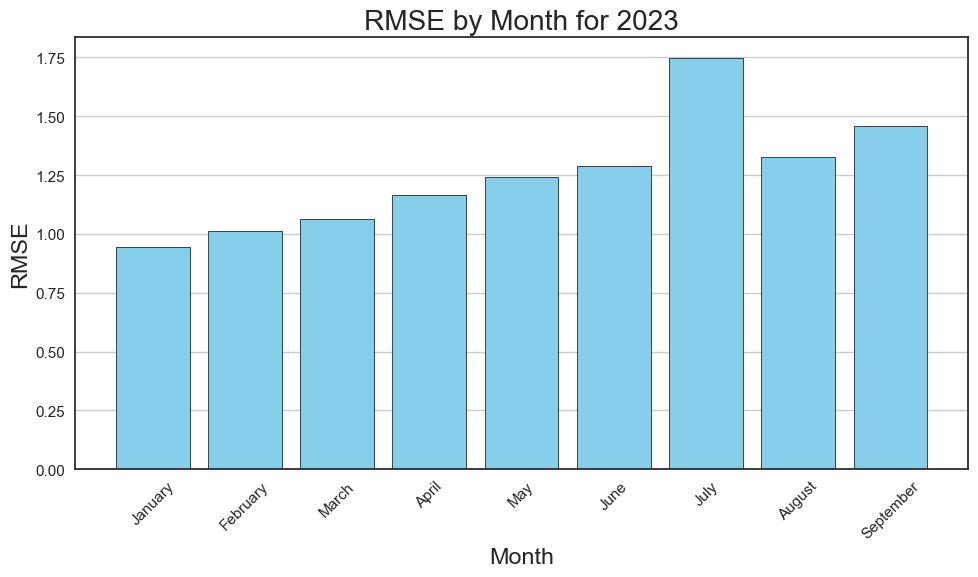

In [ ]:
plot_compare(answer,leadtime_10_pred)
plot_month(answer,leadtime_10_pred,10)

## leadtime 30

In [ ]:
leadtime_30_pred = predict_wl_level(ppd_data2, 30)
leadtime_30_pred.to_csv("../result/leadtime(30).csv")

##################################################
Leadtime 30 predict start
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 2, number of used features: 0
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 3060 Ti, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 16 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Warning] GPU acceleration is disabled because no non-trivial dense features can be found
[LightGBM] [Info] Start training from score 0.500000
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the spl

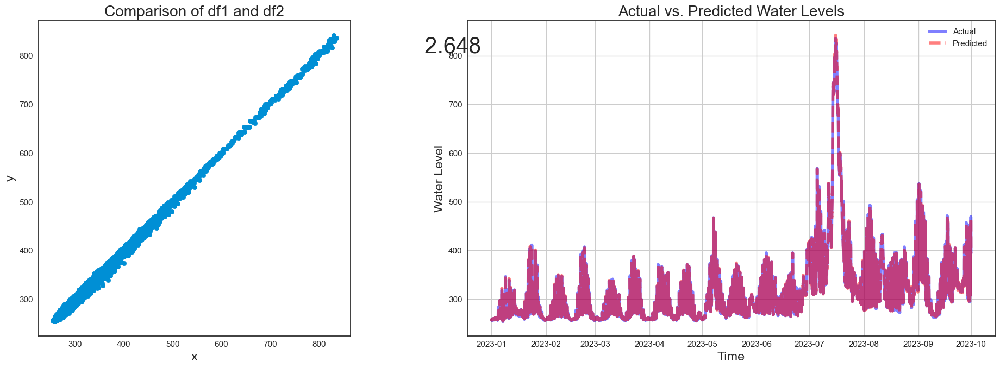

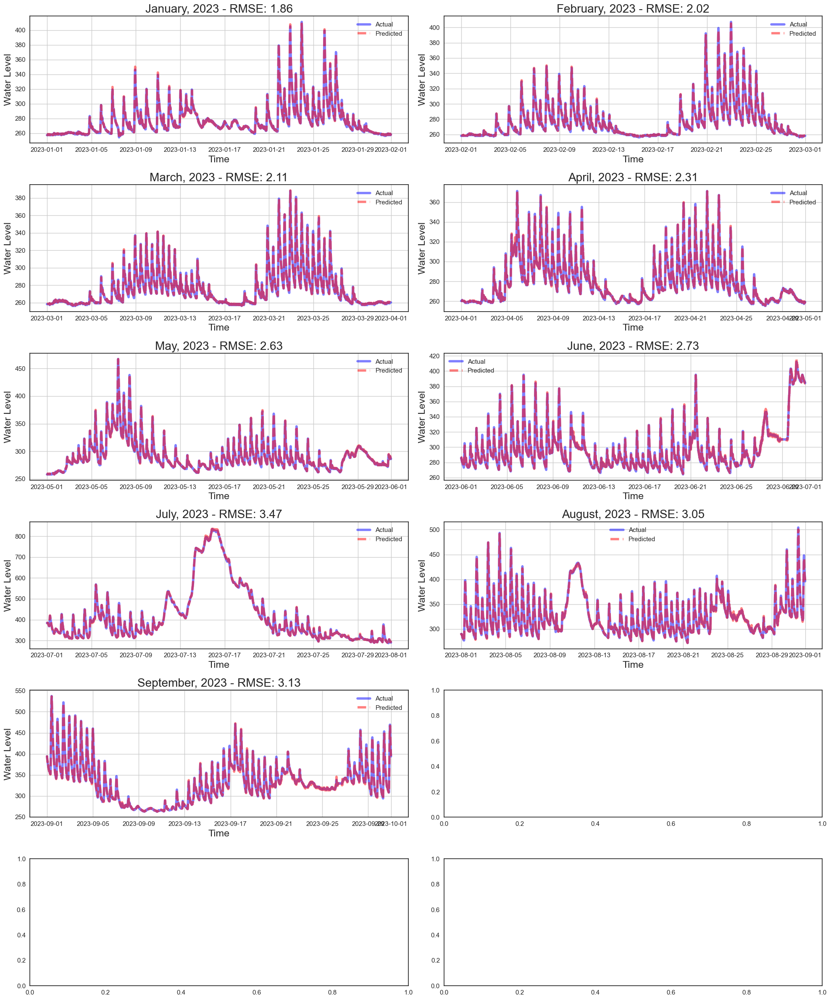

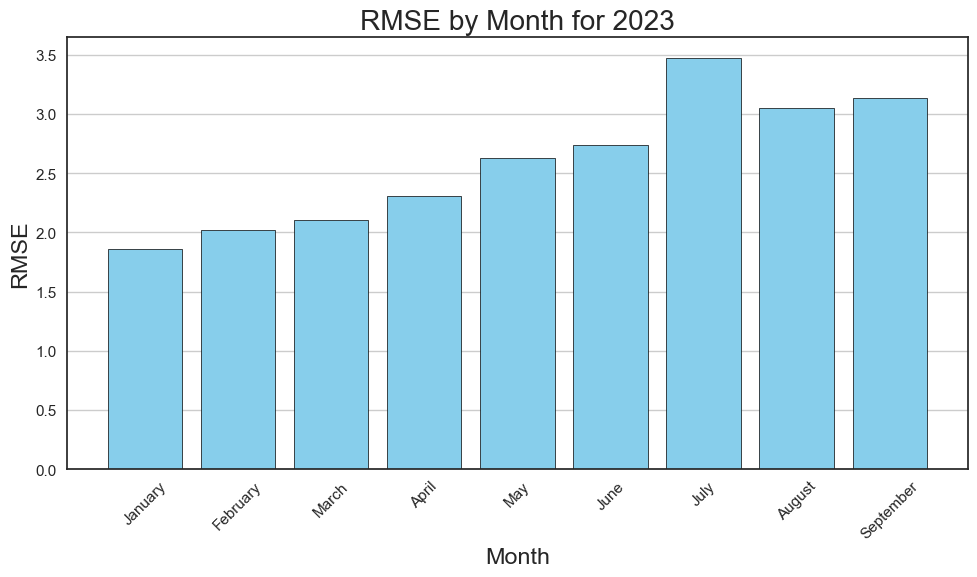

In [ ]:
plot_compare(answer,leadtime_30_pred)
plot_month(answer,leadtime_30_pred,12)

## leadtime 60

In [ ]:
leadtime_60_pred = predict_wl_level(ppd_data2, 60)
leadtime_60_pred.to_csv("../result/leadtime(60).csv")

##################################################
Leadtime 60 predict start
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 2, number of used features: 0
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 3060 Ti, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 16 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Warning] GPU acceleration is disabled because no non-trivial dense features can be found
[LightGBM] [Info] Start training from score 0.500000
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the spl

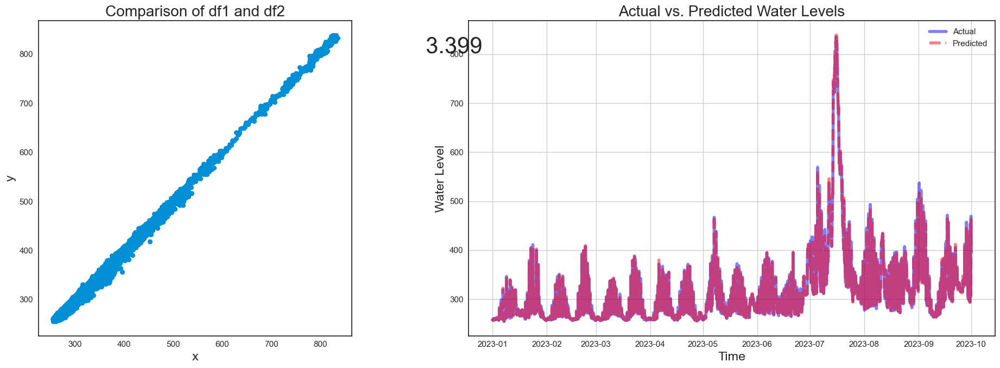

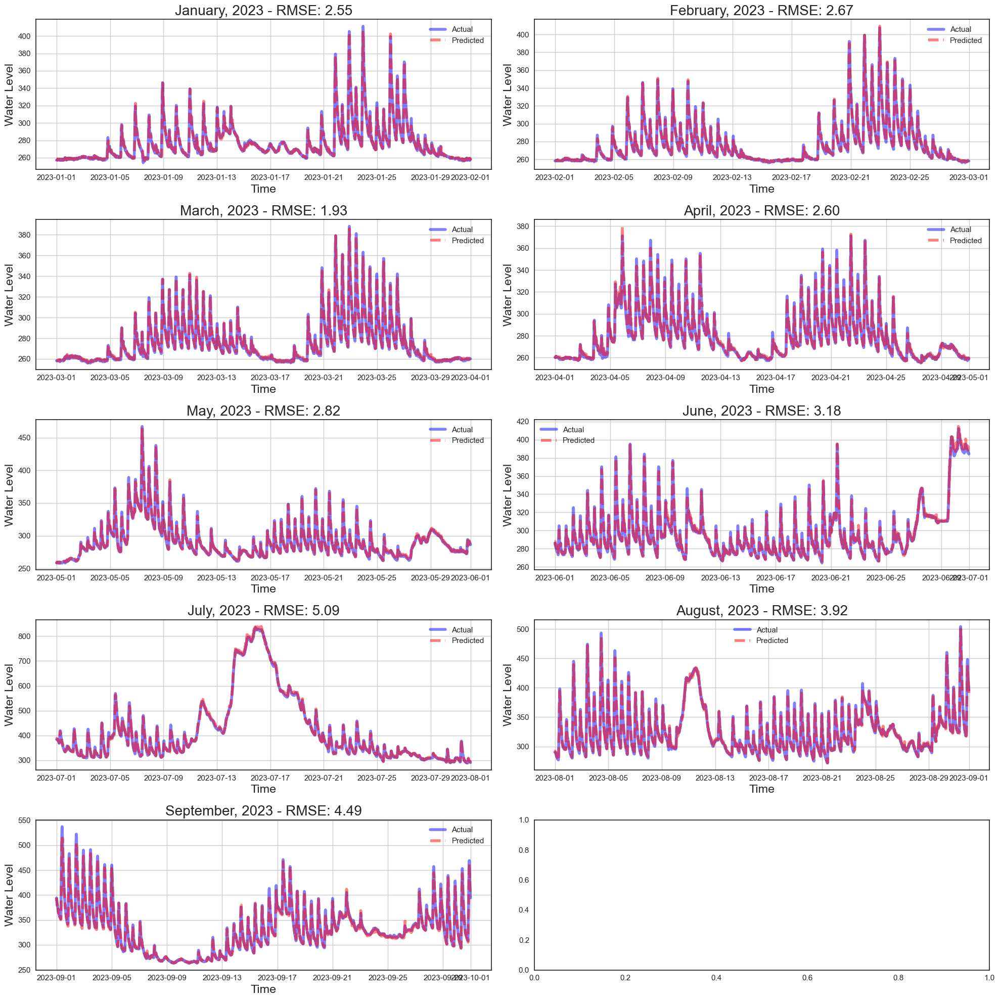

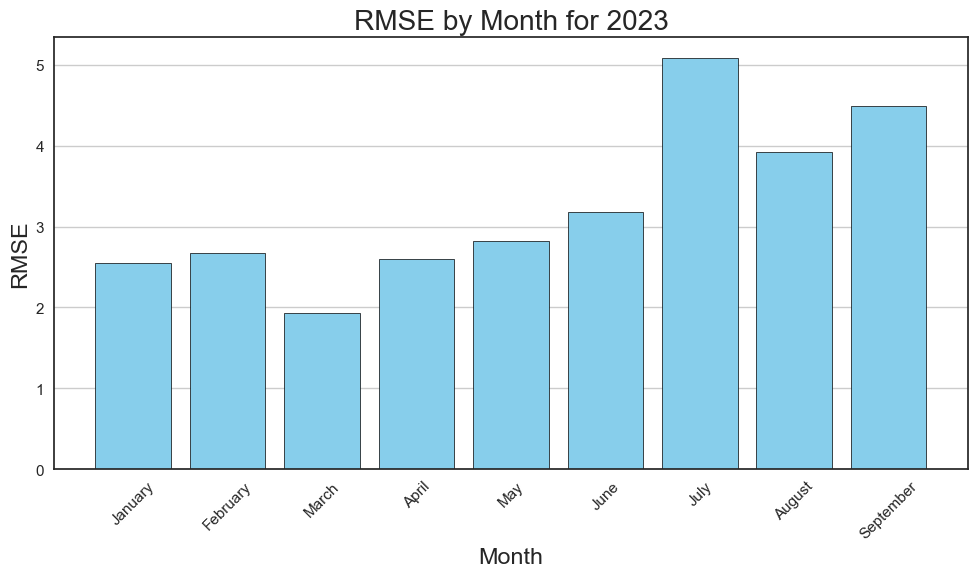

In [ ]:
plot_compare(answer,leadtime_60_pred)
plot_month(answer,leadtime_60_pred,10)

## leadtime 180

In [ ]:
leadtime_180_pred = predict_wl_level(ppd_data2, 180)
leadtime_180_pred.to_csv("../result/leadtime(180).csv")

##################################################
Leadtime 180 predict start
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 2, number of used features: 0
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 3060 Ti, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 16 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Warning] GPU acceleration is disabled because no non-trivial dense features can be found
[LightGBM] [Info] Start training from score 0.500000
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the sp

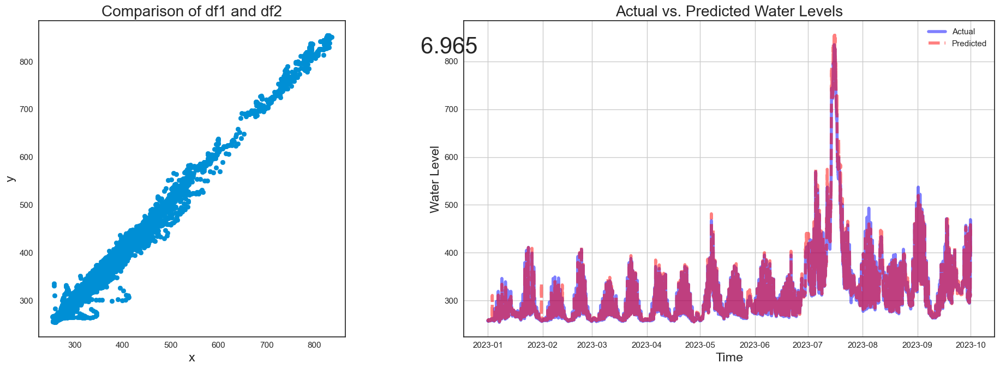

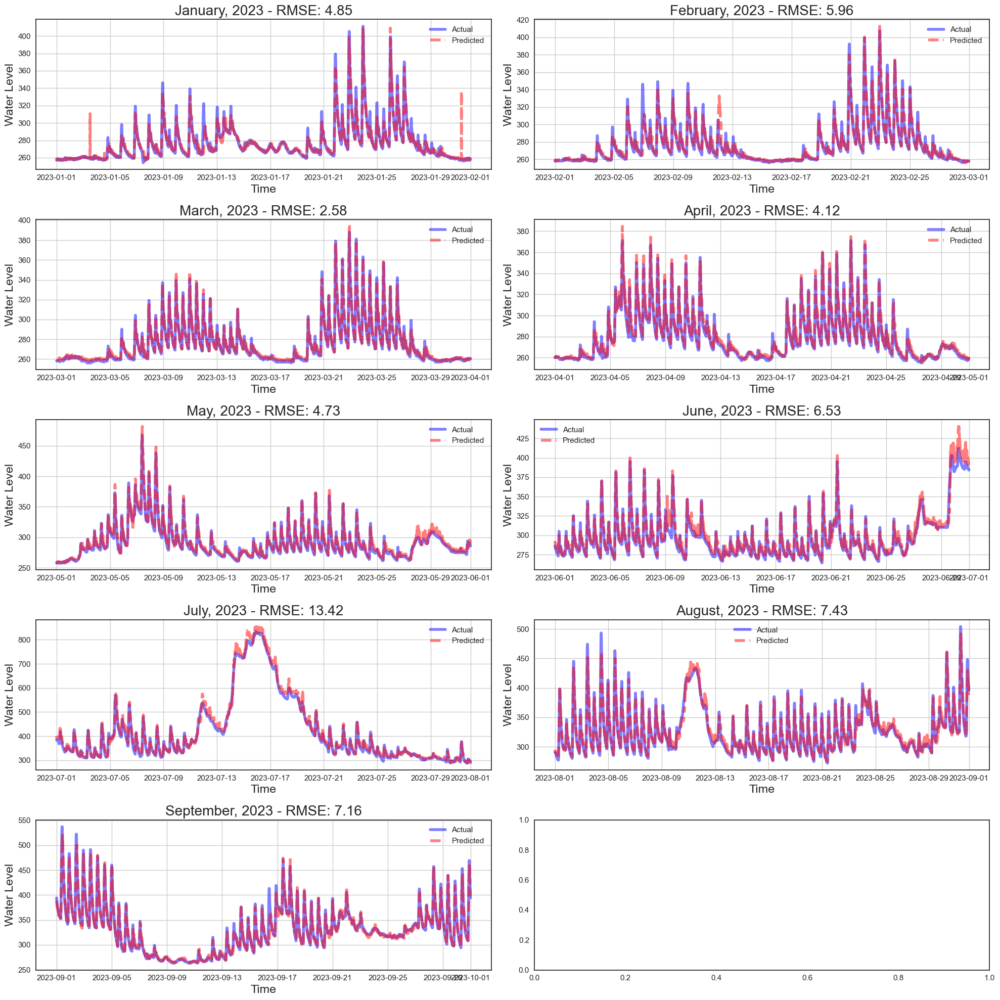

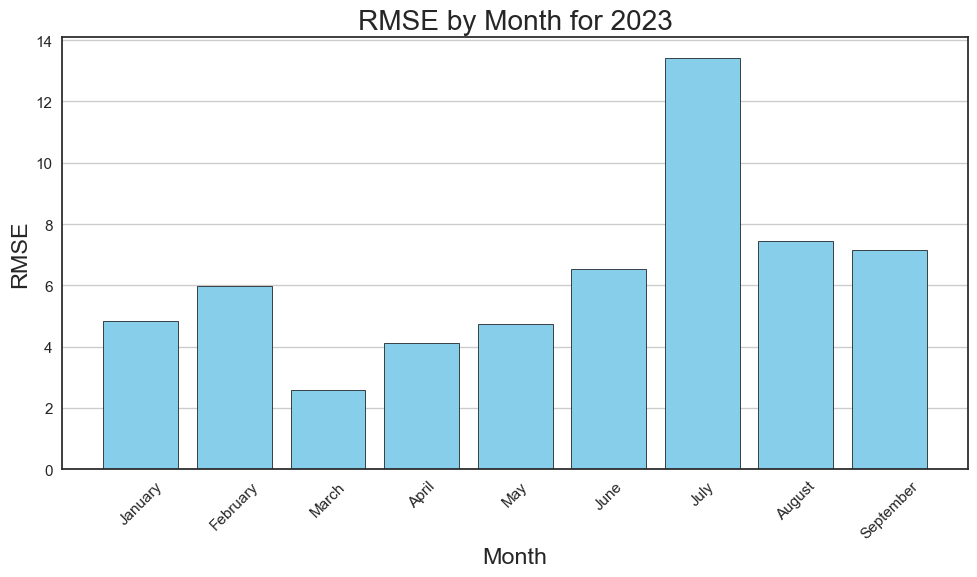

In [ ]:
plot_compare(answer,leadtime_180_pred)
plot_month(answer,leadtime_180_pred,10)

## leadtime 360

In [ ]:
leadtime_360_pred = predict_wl_level(ppd_data2, 360)
leadtime_360_pred.to_csv("../result/leadtime(360).csv")

##################################################
Leadtime 360 predict start
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 2, number of used features: 0
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 3060 Ti, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 16 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Warning] GPU acceleration is disabled because no non-trivial dense features can be found
[LightGBM] [Info] Start training from score 0.500000
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the sp

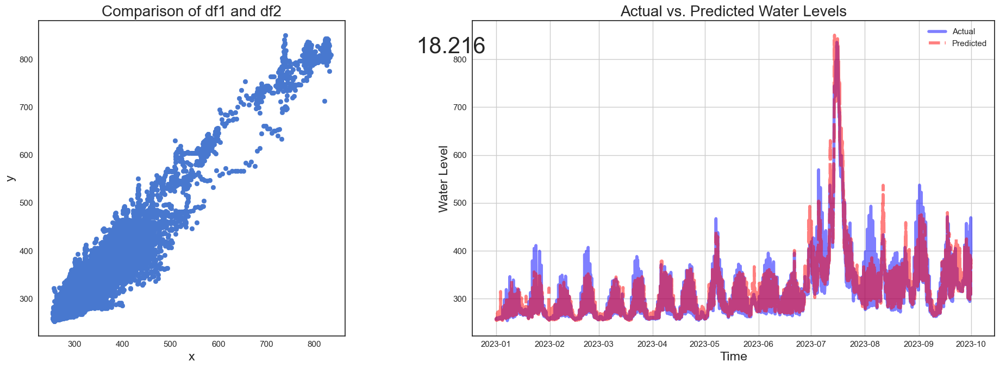

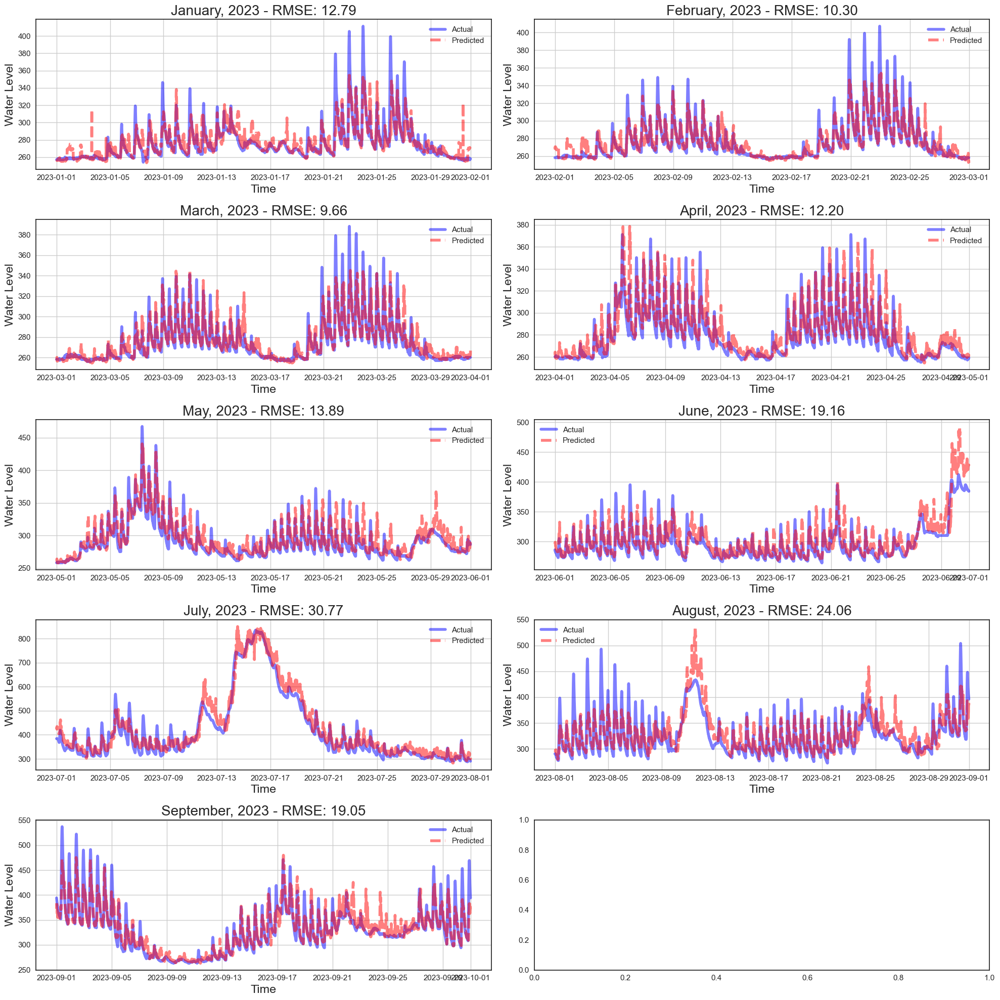

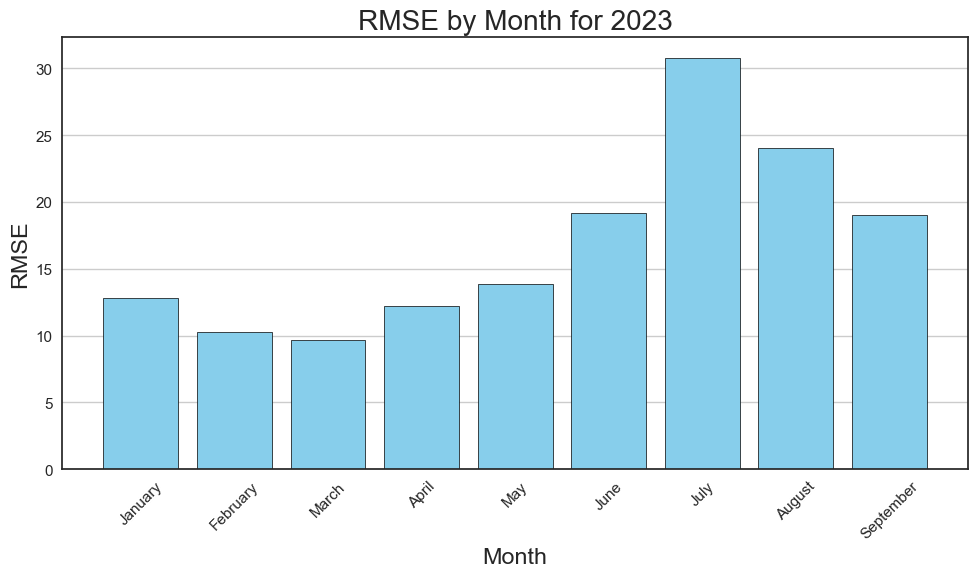

In [ ]:
plot_compare(answer,leadtime_360_pred)
plot_month(answer,leadtime_360_pred,10)

# analyze result

Transformation Pipeline and Model Successfully Loaded
Transformation Pipeline and Model Successfully Loaded
Transformation Pipeline and Model Successfully Loaded
Transformation Pipeline and Model Successfully Loaded
Transformation Pipeline and Model Successfully Loaded


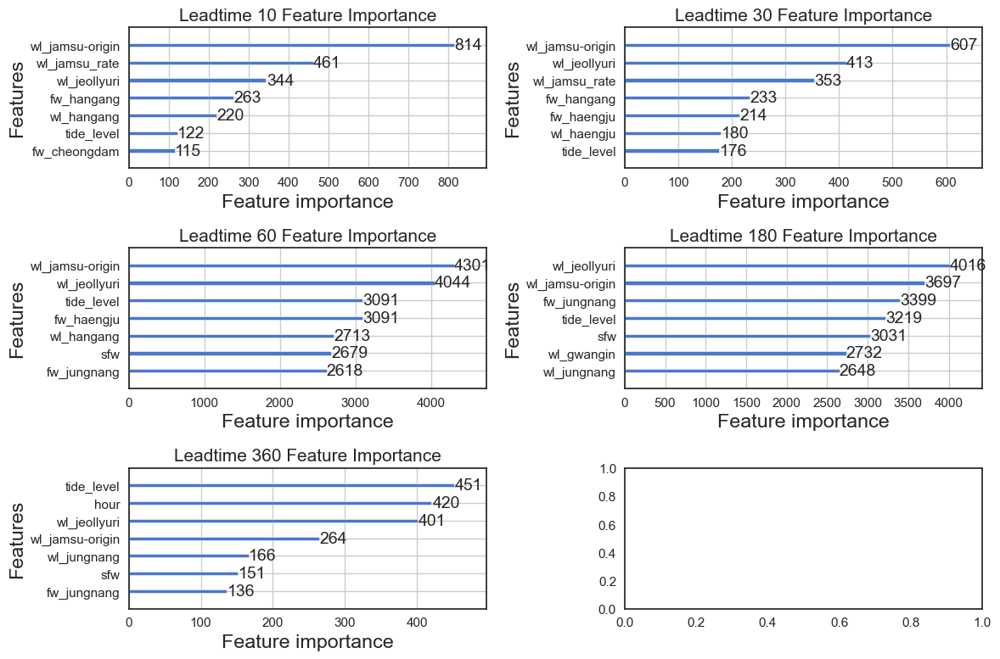

In [ ]:
leadtime_list = [10, 30, 60, 180, 360]
max_n = 7

fig, axes = plt.subplots(3, 2, figsize=(12, 8))

for i, leadtime in enumerate(leadtime_list):
    row = i // 2
    col = i % 2
    ax = axes[row, col]
    feature_importance(leadtime, max_n)

plt.tight_layout()
plt.show();
fig.savefig(f'../image/feature_importance.png', bbox_inches='tight');


In [ ]:
# 3개의 모델(전체월, 비홍수기, 홍수기)을 이용하여 test 셋의 rmse를 가장 잘 예측한 모델을 확인.

overall_rmse_list = []

for leadtime in leadtime_list:
    print("#" * 50)
    print(f"Predict report for Leadtime {leadtime}:\n")
    dataframes = [pd.read_csv(f"../result/leadtime({leadtime})/final_model-{model_num}.csv", index_col='ymdhm') for model_num in range(1, 4)]

    monthly_rmse_best = pd.DataFrame(index=range(1, 10), columns=['Model 1', 'Model 2', 'Model 3', 'Best Model'])

    for month in range(1, 10):
        best_rmse, best_model_name = float('inf'), None
        for i, model in enumerate(dataframes):
            model.index = pd.to_datetime(model.index)
            model_month = model[model.index.month == month]
            answer_month = answer[answer.index.month == month] 

            if not model_month.empty and not answer_month.empty:
                rmse = sqrt(mean_squared_error(answer_month, model_month))
                monthly_rmse_best.loc[month, f'Model {i+1}'] = rmse

                if rmse < best_rmse:
                    best_rmse, best_model_name = rmse, f'Model {i+1}'

        monthly_rmse_best.loc[month, 'Best Model'] = best_model_name

    print(monthly_rmse_best)

    # 각 월마다 가장 잘 예측한 모델의 rmse를 합침 .
    best_model_rmses = [monthly_rmse_best.loc[month, best_model] for month, best_model in enumerate(monthly_rmse_best['Best Model'], start=1)]
    overall_rmse = sqrt(np.mean(np.square(best_model_rmses)))
    overall_rmse_list.append(overall_rmse)

    print(f"Total RMSE for Leadtime {leadtime}: {overall_rmse}")


##################################################
Predict report for Leadtime 10:

    Model 1    Model 2   Model 3 Best Model
1  0.983904    0.94573  0.999782    Model 2
2  1.066816   1.013845  1.084902    Model 2
3   1.06171   1.040439  1.108066    Model 2
4  1.166875    1.13219  1.229553    Model 2
5  1.242112   1.233265   1.26584    Model 2
6  1.288122   1.306489  1.308411    Model 1
7  1.980046  16.385351  1.747656    Model 3
8  1.326638   1.550561  1.326978    Model 1
9  1.457691   1.729835  1.403951    Model 3
Total RMSE for Leadtime 10: 1.2584030733371139
##################################################
Predict report for Leadtime 30:

    Model 1    Model 2   Model 3 Best Model
1  1.938136    1.85741  2.121625    Model 2
2  2.140622   2.023602  2.470947    Model 2
3  2.105189   2.008012  2.290884    Model 2
4  2.307805   2.294055  2.470208    Model 2
5  2.626578   2.671462  2.699631    Model 1
6  2.734462    2.95625  2.872287    Model 1
7  3.568621  42.463196  3.472752    M